# SegmenTron: Segmentación y Clasificación de Lesiones

En este notebook, exploraremos la combinación de U-Net para la segmentación de regiones de interés y Detectron para la clasificación de lesiones.

## Objetivos

- Implementar una arquitectura U-Net para segmentar y mejorar la visualización de las regiones de interés.
- Utilizar Detectron para clasificar las lesiones en las regiones segmentadas.

![Gráfica de Ejemplo](ruta/a/tu/imagen.png)


## 1. Configuración del entorno

En esta sección se realiza la configuración inicial del entorno de trabajo para el desarrollo de la arquitectura **SegmenTron**. Esto incluye:

- Importación de librerías

- Configuración de rutas base

- Verificación de la disponibilidad de GPU para el entrenamiento de modelos de Deep Learning.
  
### 📦 1.1 Importación de librerías


In [1]:
# Manejo de archivos y datos
import os                # Interacción con el sistema de archivos
import numpy as np       # Para trabajar con arreglos numéricos y matrices
import pandas as pd      # Para trabajar con DataFrames (gestión de datos)
from glob import glob    # Para buscar archivos mediante patrones
import random            # Para generación de valores aleatorios
import uuid              # Para generar UUIDs únicos para segmentaciones

# Visualización
import matplotlib.pyplot as plt  # Para graficar durante el entrenamiento
import seaborn as sns          # Para visualización avanzada de datos
from PIL import Image          # Para manipulación de imágenes (cargar, guardar)

# Procesamiento de imágenes
import cv2                    # Para leer, modificar y procesar imágenes
from sklearn.model_selection import train_test_split  # Para dividir los datos en entrenamiento y prueba

# Deep Learning con TensorFlow/Keras
import tensorflow as tf               # Framework de Deep Learning
from tensorflow.keras import layers    # Capas para redes neuronales
from tensorflow.keras.models import Model  # Para modelos secuenciales y funcionales
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping  # Para guardar los mejores modelos y evitar sobreajuste
from tensorflow.keras.optimizers import Adam  # Optimizador Adam
from tensorflow.keras.metrics import MeanIoU   # Métrica para segmentación

# Utilidades
from tqdm import tqdm            # Para mostrar progreso en loops
import warnings                 # Para manejar advertencias

# Otros
import h5py                     # Para guardar y cargar archivos HDF5 (checkpoints)
import joblib                   # Para guardar modelos entrenados
from pathlib import Path


2025-04-13 08:14:01.010653: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-13 08:14:01.046806: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-04-13 08:14:01.046836: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-04-13 08:14:01.046858: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-13 08:14:01.053467: I tensorflow/core/platform/cpu_feature_g

### ⚙️ 1.2 Configuración de rutas

In [2]:
# Ruta base del proyecto
BASE_DIR = Path.cwd()

# Carpetas principales
INTEL_DIR = BASE_DIR / "Intel"
CAIME_DIR = BASE_DIR / "CAIME"
ROIS_DIR = BASE_DIR / "rois"  # 📂 Nueva carpeta para ROIS
AUG_DIR = INTEL_DIR / "aumentadas"  # 📂 Carpeta para imágenes aumentadas

# CSVs
INTEL_CSV = BASE_DIR / "intel.csv"
CAIME_CSV = BASE_DIR / "caime.csv"
ROIS_CSV = BASE_DIR / "rois.csv"  # 📂 CSV correspondiente para ROIS
SelectedVAR = BASE_DIR / "SelectedVarV2.csv"

### 🧠 1.3 Verificación de GPU

In [3]:
print("TensorFlow version:", tf.__version__)
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print(f"✅ GPU detectada: {gpus[0].name}")
else:
    print("⚠️ No se detectó GPU. El entrenamiento puede ser más lento.")


TensorFlow version: 2.14.0
✅ GPU detectada: /physical_device:GPU:0


## 🔹 2. Carga y visualización de datos

In [4]:
# Cargar CSVs
df_caime = pd.read_csv(CAIME_CSV)
df_intel = pd.read_csv(INTEL_CSV)

df_selectedvar = pd.read_csv(SelectedVAR)

# Vista previa de CAIME
display(df_caime.head())

# Vista previa de INTEL
display(df_intel.head())




,NombreImg,code,classification,hallazgos,Class,lesion
0,Colpo_01.jpg,1473,Normal,NaN,0.0,av
1,Colpo_010.jpg,1468,Normal,NaN,0.0,aw
2,Colpo_0100.jpg,1464,Normal,NaN,0.0,aw
3,Colpo_0101.jpg,1456,Normal,NaN,0.0,n
4,Colpo_0102.jpg,1440,Normal,NaN,0.0,n


,imagen_original,mascara_segmentacion,tipo_lesion
0,10.jpg,10-av.tif,av
1,10.jpg,10-aw.tif,aw
2,1001.jpg,1001-m.tif,m
3,1005.jpg,1005-aw.tif,aw
4,1025.jpg,1025-aw.tif,aw


In [5]:
# Vista previa y estadísticas de SelectedVAR
display(df_selectedvar.head())
display(df_selectedvar.describe())


,codigo,date,Edad,embarazos,partos,NumParejaSexual,Anticonceptivos(DIU),Tabaquismo,HistoriaCCV,VacunaVPH,NivelInstruccion,EstadoCivil,EdadinicioSex,NumPap,UltimoExamen,Tiene_hijos,DetecccionOportuna
0,267360985,1957-11-11,65,3,3,2,1,0,0,1,2,2,29,5,3,0,0
1,267382744,1988-07-16,34,1,1,1,1,0,0,1,4,2,22,4,3,0,1
2,267382746,1965-02-21,58,6,6,2,1,0,1,1,2,6,18,6,3,0,1
3,267382749,1973-01-27,50,2,2,1,0,0,0,1,2,2,27,10,1,0,1
4,267382753,1994-03-21,29,2,2,4,1,0,1,0,3,2,15,4,1,0,1


,codigo,Edad,embarazos,partos,NumParejaSexual,Anticonceptivos(DIU),Tabaquismo,HistoriaCCV,VacunaVPH,NivelInstruccion,EstadoCivil,EdadinicioSex,NumPap,UltimoExamen,Tiene_hijos,DetecccionOportuna
count,1.897000e+03,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000,1897.000000
mean,2.860467e+08,42.128097,2.730627,2.496574,1.360569,0.505535,0.031629,0.071692,0.486031,2.579863,2.338956,20.210332,5.486031,1.681603,0.002636,0.692145
std,9.121116e+06,14.791410,2.205831,2.046947,0.945054,0.500101,0.175056,0.258046,0.499937,0.854422,1.459555,5.956465,5.824974,1.342994,0.051285,0.461728
min,2.673610e+08,18.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,11.000000,0.000000,0.000000,0.000000,0.000000
25%,2.783217e+08,30.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000,1.000000,17.000000,1.000000,1.000000,0.000000,0.000000
50%,2.875649e+08,41.000000,2.000000,2.000000,1.000000,1.000000,0.000000,0.000000,0.000000,3.000000,2.000000,19.000000,4.000000,1.000000,0.000000,1.000000
75%,2.929371e+08,54.000000,4.000000,3.000000,2.000000,1.000000,0.000000,0.000000,1.000000,3.000000,2.000000,22.000000,8.000000,3.000000,0.000000,1.000000
max,3.018877e+08,70.000000,13.000000,13.000000,10.000000,1.000000,1.000000,1.000000,1.000000,5.000000,6.000000,50.000000,35.000000,4.000000,1.000000,1.000000


In [6]:
# Conteo de valores nulos
missing = df_selectedvar.isnull().sum()
missing = missing[missing > 0].sort_values(ascending=False)

if not missing.empty:
    plt.figure(figsize=(8, 4))
    sns.barplot(x=missing.values, y=missing.index, palette='Reds')
    plt.title("Valores nulos por variable en SelectedVAR")
    plt.xlabel("Cantidad de valores nulos")
    plt.tight_layout()
    plt.show()
else:
    print("✅ No se encontraron valores nulos en SelectedVAR.")


✅ No se encontraron valores nulos en SelectedVAR.


## 3. Procesamiento de datos

### 🟩 3.1 Preparación de las imágenes

En esta parte, vamos a adaptar el código para que cargue las imágenes desde la carpeta **ROIS** (en lugar de las anteriores de clasificación) y solo realice la segmentación de la región de interés del cérvix. Se eliminará la parte de las clases de lesiones y el aumento de datos.

- **Leer las imágenes** `.jpg` y sus correspondientes máscaras `.tif` de la carpeta **ROIS**.
- **Segmentación de la región de interés**: Sólo se segmentará el área de interés, sin preocuparse por la clasificación de lesiones.
- **Redimensionar a 256x256** para asegurar que las imágenes y máscaras tengan un tamaño uniforme.
- **Normalización de las imágenes**.
- **Visualización de los ejemplos segmentados**.


In [7]:
# 🟩 3.1 Preparación de las imágenes

# Tamaño objetivo para redimensionamiento
TARGET_SIZE = (256, 256)

# 🧠 Funciones auxiliares

# Cargar imagen y máscara, y redimensionar a tamaño objetivo
def load_image_and_mask(img_path, mask_path, target_size):
    img = Image.open(img_path).convert("RGB").resize(target_size)
    mask = Image.open(mask_path).convert("L").resize(target_size)  # Solo para máscara
    img = np.array(img) / 255.0  # Normalizar imagen
    mask = np.array(mask)  # La máscara ya está en blanco y negro (0 y 255)
    return img, mask

# 📂 Crear DataFrame base para las imágenes y sus máscaras
def create_dataframe_for_rois(image_dir, mask_dir):
    image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]
    mask_files = [f for f in os.listdir(mask_dir) if f.endswith('.tif')]

    df_imagenes = []
    for img_name in image_files:
        base = img_name.split('.')[0]  # Nombre de la imagen sin extensión
        mask_name = next((m for m in mask_files if m.startswith(base)), None)  # Buscar máscara correspondiente
        if mask_name:
            df_imagenes.append({
                "imagen": img_name,
                "mascara": mask_name
            })

    df_imagenes = pd.DataFrame(df_imagenes)
    return df_imagenes

# 📄 Crear el DataFrame con las imágenes y sus máscaras correspondientes
df_imagenes = create_dataframe_for_rois(ROIS_DIR, ROIS_DIR)

In [8]:
# 📄 Crear el DataFrame con las imágenes y sus máscaras correspondientes
df_imagenes = create_dataframe_for_rois(ROIS_DIR, ROIS_DIR)
df_imagenes


,imagen,mascara
0,2858 - copia.jpg,2858 - copia.tif
1,4018.jpg,4018.tif
2,4031.jpg,4031.tif
3,2715.jpg,2715.tif
4,3877 - copia.jpg,3877 - copia.tif
...,...,...
306,3575 - copia.jpg,3575 - copia.tif
307,3740 - copia.jpg,3740 - copia.tif
308,2425.jpg,2425.tif
309,464.jpg,464.tif


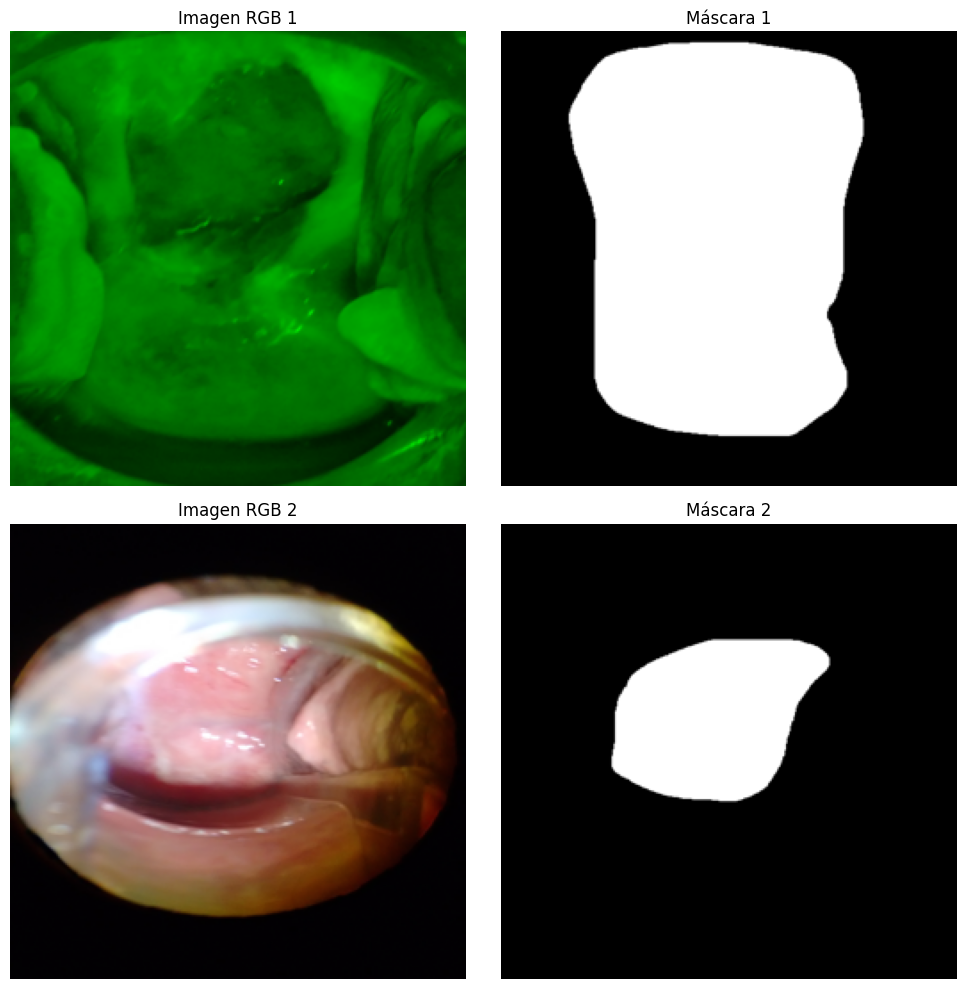

In [9]:
# 🎨 Visualizar ejemplos
sample_data = []
for i in range(2):  # Mostrar dos ejemplos
    row = df_imagenes.iloc[i]
    img, mask = load_image_and_mask(ROIS_DIR / row["imagen"], ROIS_DIR / row["mascara"], TARGET_SIZE)
    sample_data.append((img, mask))

# Visualización de las imágenes y sus máscaras
fig, axes = plt.subplots(len(sample_data), 2, figsize=(10, len(sample_data) * 5))
for i, (img, mask) in enumerate(sample_data):
    axes[i, 0].imshow(img)
    axes[i, 0].set_title(f"Imagen RGB {i+1}")
    axes[i, 0].axis('off')
    axes[i, 1].imshow(mask, cmap='gray')
    axes[i, 1].set_title(f"Máscara {i+1}")
    axes[i, 1].axis('off')
plt.tight_layout()
plt.show()

In [10]:

# 📂 División en conjuntos de entrenamiento, validación y prueba
train_val_df, test_df = train_test_split(
    df_imagenes, test_size=0.15, random_state=42
)

train_df, val_df = train_test_split(
    train_val_df, test_size=0.1765, random_state=42
)

# 📊 Mostrar tamaños y proporciones
total = len(df_imagenes)
print(f"📚 Total imágenes: {total}")
print(f"✅ Entrenamiento: {len(train_df)} imágenes ({len(train_df)/total:.1%})")
print(f"🧪 Validación:   {len(val_df)} imágenes ({len(val_df)/total:.1%})")
print(f"🧾 Prueba:       {len(test_df)} imágenes ({len(test_df)/total:.1%})")

📚 Total imágenes: 311
✅ Entrenamiento: 217 imágenes (69.8%)
🧪 Validación:   47 imágenes (15.1%)
🧾 Prueba:       47 imágenes (15.1%)


## 🔹 4. Modelo UNet – Segmentación y Clasificación de Lesión

📌 **Características del modelo**:
- **Entrada**: Imagen RGB (256, 256, 3)
- **Salida**: Máscara (256, 256, 4) con 4 canales (una por clase: AW, M, P, AV)
- **Activación final**: softmax (para segmentación multiclase)
- **Función de pérdida**: categorical_crossentropy
- **Métricas**: IoU (Intersection over Union) y Dice Score, calculadas por clase.

### 4.1: Definición de la arquitectura U-Net


In [11]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import Adam

def unet_roi_model(input_size=(128, 128, 3)):
    inputs = layers.Input(input_size)
    
    # Codificador (más liviano)
    c1 = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(inputs)
    c1 = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(c1)
    p1 = layers.MaxPooling2D((2, 2))(c1)

    c2 = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(p1)
    c2 = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(c2)
    p2 = layers.MaxPooling2D((2, 2))(c2)

    c3 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(p2)
    c3 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c3)
    p3 = layers.MaxPooling2D((2, 2))(c3)

    c4 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(p3)
    c4 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(c4)

    # Decodificador (simétrico)
    u5 = layers.Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c4)
    u5 = layers.concatenate([u5, c3])
    c5 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(u5)
    c5 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c5)

    u6 = layers.Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c5)
    u6 = layers.concatenate([u6, c2])
    c6 = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(u6)
    c6 = layers.Conv2D(32, (3, 3), activation='relu', padding='same')(c6)

    u7 = layers.Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = layers.concatenate([u7, c1])
    c7 = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(u7)
    c7 = layers.Conv2D(16, (3, 3), activation='relu', padding='same')(c7)

    outputs = layers.Conv2D(1, (1, 1), activation='sigmoid')(c7)

    model = models.Model(inputs, outputs)
    return model

# Función de pérdida Dice Loss
def dice_loss(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.reshape(tf.cast(y_true, tf.float32), [-1])
    y_pred_f = tf.reshape(tf.cast(y_pred, tf.float32), [-1])
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return 1 - ((2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth))

# Crear y compilar el modelo
input_size = (128, 128, 3)  # puedes volver a 256x256 si es necesario
model = unet_roi_model(input_size=input_size)
model.compile(optimizer=Adam(learning_rate=1e-4), loss=dice_loss, metrics=['accuracy'])

# Mostrar resumen
model.summary()



Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 128, 128, 16)         448       ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 128, 128, 16)         2320      ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 64, 64, 16)           0         ['conv2d_1[0][0]']            
 D)                                                                                           

2025-04-13 08:14:03.458269: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1886] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 47207 MB memory:  -> device: 0, name: Quadro RTX 8000, pci bus id: 0000:17:00.0, compute capability: 7.5
2025-04-13 08:14:03.458782: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1886] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 46975 MB memory:  -> device: 1, name: Quadro RTX 8000, pci bus id: 0000:98:00.0, compute capability: 7.5


 concatenate_2 (Concatenate  (None, 128, 128, 32)         0         ['conv2d_transpose_2[0][0]',  
 )                                                                   'conv2d_1[0][0]']            
                                                                                                  
 conv2d_12 (Conv2D)          (None, 128, 128, 16)         4624      ['concatenate_2[0][0]']       
                                                                                                  
 conv2d_13 (Conv2D)          (None, 128, 128, 16)         2320      ['conv2d_12[0][0]']           
                                                                                                  
 conv2d_14 (Conv2D)          (None, 128, 128, 1)          17        ['conv2d_13[0][0]']           
                                                                                                  
Total params: 482033 (1.84 MB)
Trainable params: 482033 (1.84 MB)
Non-trainable params: 0 (0.00 Byte)
_______

In [12]:
import tensorflow as tf
from tensorflow.keras import layers, models

def unet_model(input_size=(256, 256, 3)):
    inputs = layers.Input(input_size)
    
    # Codificador (contracción)
    c1 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    c1 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c1)
    p1 = layers.MaxPooling2D((2, 2))(c1)

    c2 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(p1)
    c2 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(c2)
    p2 = layers.MaxPooling2D((2, 2))(c2)

    c3 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(p2)
    c3 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(c3)
    p3 = layers.MaxPooling2D((2, 2))(c3)

    c4 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(p3)
    c4 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(c4)
    p4 = layers.MaxPooling2D((2, 2))(c4)

    c5 = layers.Conv2D(1024, (3, 3), activation='relu', padding='same')(p4)
    c5 = layers.Dropout(0.3)(c5)  # <--- Añadir esto
    c5 = layers.Conv2D(1024, (3, 3), activation='relu', padding='same')(c5)

    # Decodificador (expansión)
    u6 = layers.Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(c5)
    u6 = layers.concatenate([u6, c4])
    c6 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(u6)
    c6 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(c6)

    u7 = layers.Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = layers.concatenate([u7, c3])
    c7 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(u7)
    c7 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(c7)

    u8 = layers.Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = layers.concatenate([u8, c2])
    c8 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(u8)
    c8 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(c8)

    u9 = layers.Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = layers.concatenate([u9, c1])
    c9 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(u9)
    c9 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c9)

    # Salida
    outputs = layers.Conv2D(1, (1, 1), activation='sigmoid')(c9)  # Usamos sigmoid para segmentación binaria

    model2 = models.Model(inputs, outputs)
    
    return model2

# Definimos el modelo
input_size = (256, 256, 3)  # Tamaño de las imágenes de entrada
model2 = unet_model(input_size=input_size)

# Compilación del modelo
model2.compile(optimizer=Adam(learning_rate=1e-4), loss=dice_loss, metrics=['accuracy'])

# Resumen del modelo
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 128, 128, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 128, 128, 16)         448       ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 128, 128, 16)         2320      ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 64, 64, 16)           0         ['conv2d_1[0][0]']            
 D)                                                                                           

### 1. Cargar y Preprocesar las Imágenes y Máscaras

In [13]:
from tensorflow.keras.preprocessing.image import img_to_array, array_to_img
import numpy as np
from PIL import Image
import os
import pandas as pd
from pathlib import Path

# Definimos una función para cargar las imágenes y las máscaras
def load_image_and_mask(img_path, mask_path, target_size=(128, 128)):
    img = Image.open(img_path).convert("RGB").resize(target_size)
    mask = Image.open(mask_path).convert("L").resize(target_size)  # La máscara debe ser en escala de grises
    img = np.array(img) / 255.0  # Normalizamos la imagen
    mask = np.array(mask)  # No normalizamos la máscara, es binaria (0 o 255)
    return img, mask


### 2. Cargar los Conjuntos de Entrenamiento y Validación
Aquí cargamos los conjuntos de entrenamiento y validación. Ya tienes los DataFrames train_df, val_df y test_df, que contienen las rutas de las imágenes y sus respectivas máscaras.


In [14]:
# Función para cargar los datos desde los DataFrames
def load_data_from_dataframe(df, image_dir, mask_dir, target_size=(128, 128)):
    images = []
    masks = []
    for _, row in df.iterrows():
        img_path = os.path.join(image_dir, row['imagen'])
        mask_path = os.path.join(mask_dir, row['mascara'])
        img, mask = load_image_and_mask(img_path, mask_path, target_size)
        images.append(img)
        masks.append(mask)
    
    # Convertir las listas a arrays numpy
    images = np.array(images)
    masks = np.array(masks)
    
    # Normalización de la máscara a binaria (0 o 1)
    masks = masks / 255.0
    return images, masks

# Cargar los datos de entrenamiento y validación
train_images, train_masks = load_data_from_dataframe(train_df, ROIS_DIR, ROIS_DIR)
val_images, val_masks = load_data_from_dataframe(val_df, ROIS_DIR, ROIS_DIR)


### 3. Definir las Métricas IOU y DICE
Para evaluar la segmentación de las imágenes, implementaremos las métricas Intersection over Union (IoU) y Dice Similarity Coefficient (DICE).

In [15]:
# Métrica IoU (Intersection over Union)
def iou_metric(y_true, y_pred, threshold=0.5):
    # Asegúrate de que ambas tengan la misma forma
    y_true = tf.cast(y_true > threshold, tf.float32)
    y_pred = tf.cast(y_pred > threshold, tf.float32)
    
    # Elimina la dimensión extra de las predicciones (canal de salida)
    y_pred = tf.squeeze(y_pred, axis=-1)  # Elimina la última dimensión (el canal)

    # Verificar las formas de y_true y y_pred después de la modificación
    print(f"y_true shape: {y_true.shape}")
    print(f"y_pred shape: {y_pred.shape}")
    
    # Realizar la operación de multiplicación (producto elemento a elemento)
    intersection = tf.reduce_sum(y_true * y_pred)
    union = tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) - intersection
    return intersection / (union + 1e-6)  # Añadimos un pequeño valor para evitar divisiones por cero

# Métrica Dice (Dice Similarity Coefficient)
def dice_metric(y_true, y_pred, threshold=0.5):
    y_true = tf.cast(y_true > threshold, tf.float32)
    y_pred = tf.cast(y_pred > threshold, tf.float32)
    
    # Elimina la dimensión extra de las predicciones (canal de salida)
    y_pred = tf.squeeze(y_pred, axis=-1)  # Elimina la última dimensión (el canal)

    intersection = tf.reduce_sum(y_true * y_pred)
    return 2 * intersection / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + 1e-6)



### 4. Función de Visualización

In [16]:
class VisualizadorEntrenamiento(tf.keras.callbacks.Callback):
    def __init__(self, val_images, val_masks, epocas_a_visualizar=None, n_muestras=1):
        super().__init__()
        self.val_images = val_images
        self.val_masks = val_masks
        self.epocas_a_visualizar = epocas_a_visualizar or []
        self.n_muestras = n_muestras

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) in self.epocas_a_visualizar:
            print(f"\n🔍 Visualización de muestras - Época {epoch + 1}")
            indices = np.random.choice(len(self.val_images), self.n_muestras, replace=False)
            
            for i, idx in enumerate(indices):
                img = self.val_images[idx]
                true_mask = self.val_masks[idx]

                pred = self.model.predict(np.expand_dims(img, axis=0))[0]
                pred = np.squeeze(pred)
                pred_bin = (pred > 0.5).astype(np.uint8) * 255

                if pred_bin.shape != img.shape[:2]:
                    pred_bin = cv2.resize(pred_bin, (img.shape[1], img.shape[0]))

                segmentada = cv2.bitwise_and((img * 255).astype(np.uint8),
                                             (img * 255).astype(np.uint8),
                                             mask=pred_bin)

                plt.figure(figsize=(12, 3))
                plt.subplot(1, 4, 1)
                plt.imshow(img)
                plt.title("Imagen Original")
                plt.axis("off")

                plt.subplot(1, 4, 2)
                plt.imshow(true_mask, cmap='gray')
                plt.title("Máscara Real")
                plt.axis("off")

                plt.subplot(1, 4, 3)
                plt.imshow(pred, cmap='gray')
                plt.title("Predicción")
                plt.axis("off")

                plt.subplot(1, 4, 4)
                plt.imshow(segmentada)
                plt.title("Segmentación Extraída")
                plt.axis("off")

                plt.tight_layout()
                plt.show()


### 5. Entrenamiento del Modelo

In [17]:
import matplotlib.pyplot as plt
from tensorflow.keras.callbacks import ModelCheckpoint
import numpy as np

# Definir el callback para guardar el mejor modelo
checkpoint_callback = ModelCheckpoint('best_model.h5', save_best_only=True, monitor='val_loss', mode='min')



# Entrenamiento del modelo
epochs = 150
batch_size = 16

# 📌 Calcular cuándo mostrar visualizaciones
porcentaje_visual = 0.30
n_visualizaciones = max(int(epochs * porcentaje_visual) - 1, 1)
intervalo_visual = max(epochs // n_visualizaciones, 1)
epocas_a_visualizar = list(range(intervalo_visual, epochs + 1, intervalo_visual))
print(f"🔁 Visualizaremos cada {intervalo_visual} épocas: {epocas_a_visualizar}")

# 🔁 Métricas históricas
iou_history = []
dice_history = []
loss_history = []
val_loss_history = []

# 🖼️ Instancia del visualizador
visualizador = VisualizadorEntrenamiento(
    val_images=val_images,
    val_masks=val_masks,
    epocas_a_visualizar=epocas_a_visualizar,
    n_muestras=2
)
visualizador.model = model  # Enlazar el modelo manualmente



🔁 Visualizaremos cada 3 épocas: [3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39, 42, 45, 48, 51, 54, 57, 60, 63, 66, 69, 72, 75, 78, 81, 84, 87, 90, 93, 96, 99, 102, 105, 108, 111, 114, 117, 120, 123, 126, 129, 132, 135, 138, 141, 144, 147, 150]


Epoch 1/150


2025-04-13 08:15:00.021220: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:442] Loaded cuDNN version 8600
2025-04-13 08:15:00.726555: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7384850badc0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2025-04-13 08:15:00.726588: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Quadro RTX 8000, Compute Capability 7.5
2025-04-13 08:15:00.726594: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (1): Quadro RTX 8000, Compute Capability 7.5
2025-04-13 08:15:00.731440: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2025-04-13 08:15:00.822362: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


14/14 [==============================] - 7s 122ms/step - loss: 0.5849 - accuracy: 0.5589 - val_loss: 0.5834 - val_accuracy: 0.4736 - lr: 1.0000e-04


/usr/local/lib/python3.11/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


2/2 [==============================] - 1s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.3477096, shape=(), dtype=float32)
IoU: 0.347709596157074
DICE: 0.5160007476806641
Epoch 2/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.37340483, shape=(), dtype=float32)
IoU: 0.3734048306941986
DICE: 0.543765127658844
Epoch 3/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.36662093, shape=(), dtype=float32)
IoU: 0.3666209280490875
DICE: 0.5365363955497742

🔍 Visualización de muestras - Época 3
1/1 [==============================] - 0s 192ms/step


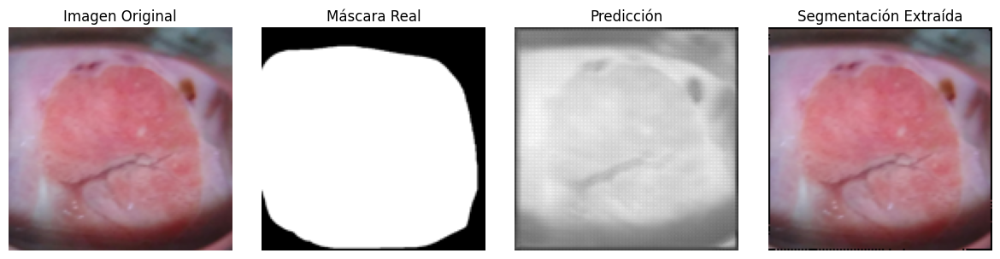

1/1 [==============================] - 0s 19ms/step


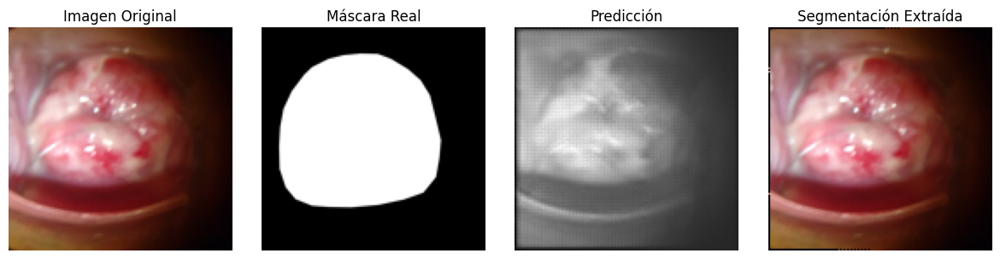

Epoch 4/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.36278835, shape=(), dtype=float32)
IoU: 0.3627883493900299
DICE: 0.5324206948280334
Epoch 5/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.36055288, shape=(), dtype=float32)
IoU: 0.3605528771877289
DICE: 0.530009388923645
Epoch 6/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.35979193, shape=(), dtype=float32)
IoU: 0.35979193449020386
DICE: 0.5291867256164551

🔍 Visualización de muestras - Época 6
1/1 [==============================] - 0s 18ms/step


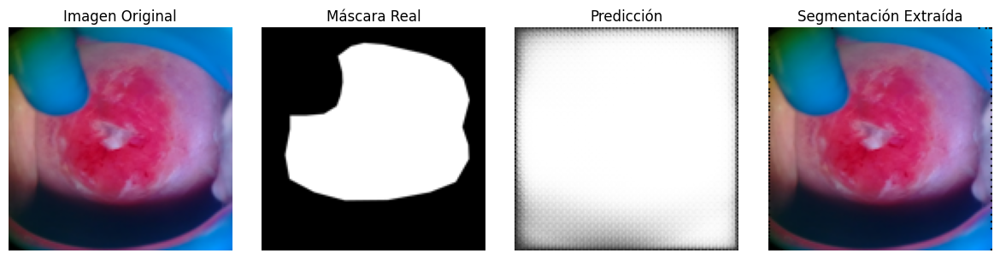

1/1 [==============================] - 0s 19ms/step


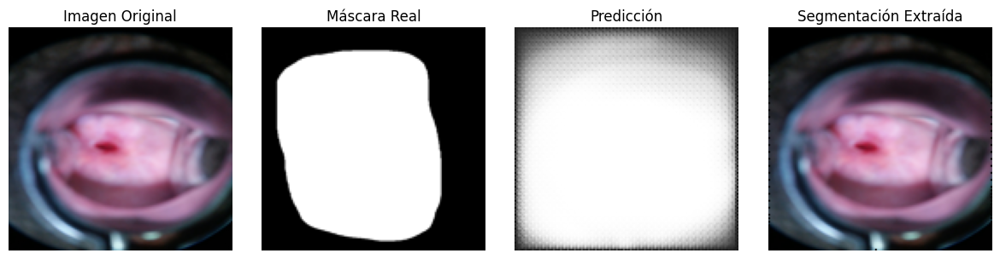

Epoch 7/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.36211333, shape=(), dtype=float32)
IoU: 0.3621133267879486
DICE: 0.5316933989524841
Epoch 8/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.3705152, shape=(), dtype=float32)
IoU: 0.37051519751548767
DICE: 0.5406947731971741
Epoch 9/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.42949966, shape=(), dtype=float32)
IoU: 0.42949965596199036
DICE: 0.6009090542793274

🔍 Visualización de muestras - Época 9
1/1 [==============================] - 0s 19ms/step


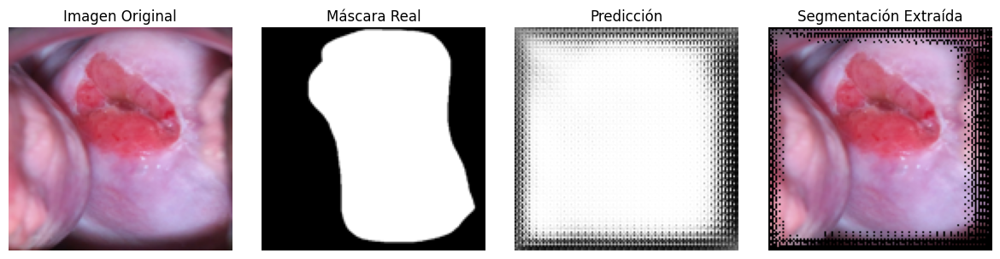

1/1 [==============================] - 0s 18ms/step


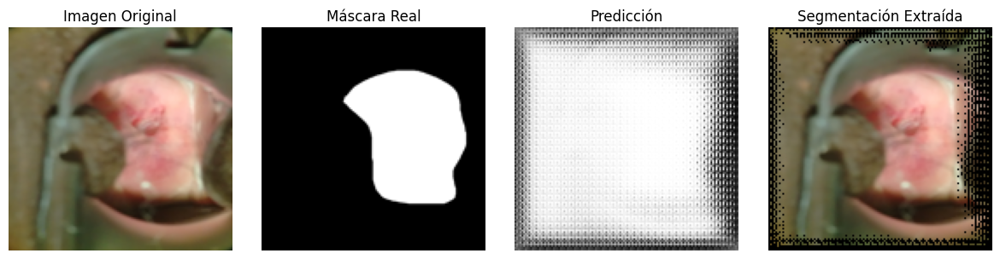

Epoch 10/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5026533, shape=(), dtype=float32)
IoU: 0.5026533007621765
DICE: 0.6690210103988647
Epoch 11/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.44223624, shape=(), dtype=float32)
IoU: 0.4422362446784973
DICE: 0.6132646203041077
Epoch 12/150
2/2 [==============================] - 0s 8ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.49330315, shape=(), dtype=float32)
IoU: 0.4933031499385834
DICE: 0.6606872081756592

🔍 Visualización de muestras - Época 12
1/1 [==============================] - 0s 20ms/step


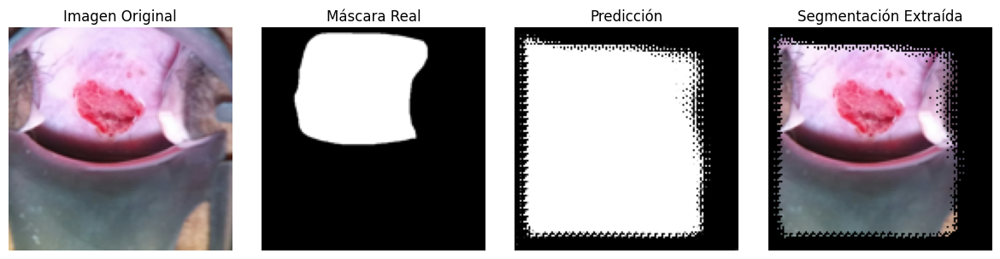

1/1 [==============================] - 0s 19ms/step


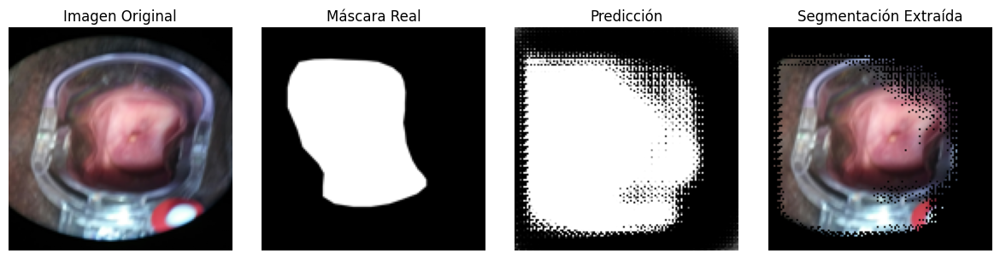

Epoch 13/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.51175594, shape=(), dtype=float32)
IoU: 0.5117559432983398
DICE: 0.6770350933074951
Epoch 14/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.53251237, shape=(), dtype=float32)
IoU: 0.532512366771698
DICE: 0.694953441619873
Epoch 15/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.53638864, shape=(), dtype=float32)
IoU: 0.536388635635376
DICE: 0.6982460021972656

🔍 Visualización de muestras - Época 15
1/1 [==============================] - 0s 19ms/step


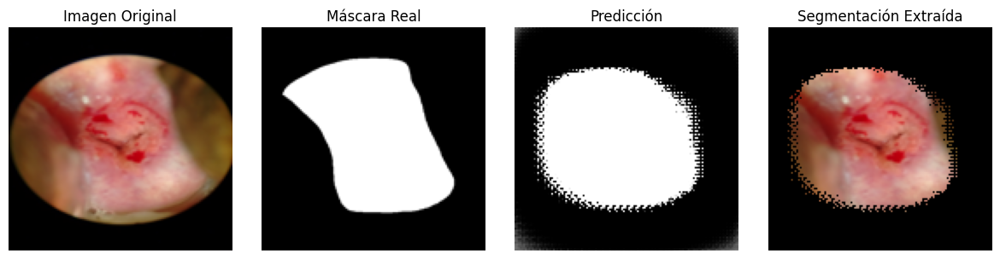

1/1 [==============================] - 0s 18ms/step


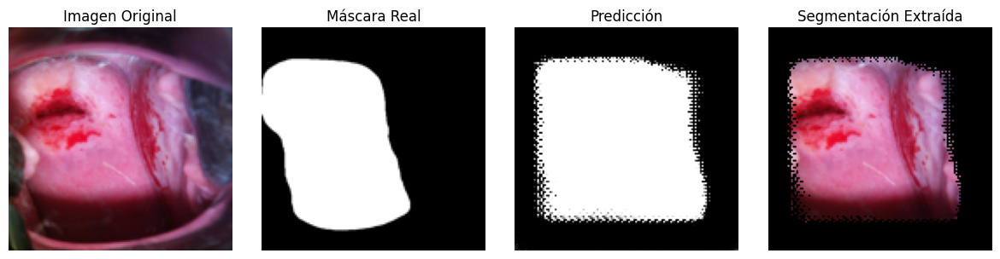

Epoch 16/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.55778444, shape=(), dtype=float32)
IoU: 0.5577844381332397
DICE: 0.7161253094673157
Epoch 17/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5774792, shape=(), dtype=float32)
IoU: 0.5774791836738586
DICE: 0.7321544289588928
Epoch 18/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5569157, shape=(), dtype=float32)
IoU: 0.5569157004356384
DICE: 0.7154089212417603

🔍 Visualización de muestras - Época 18
1/1 [==============================] - 0s 19ms/step


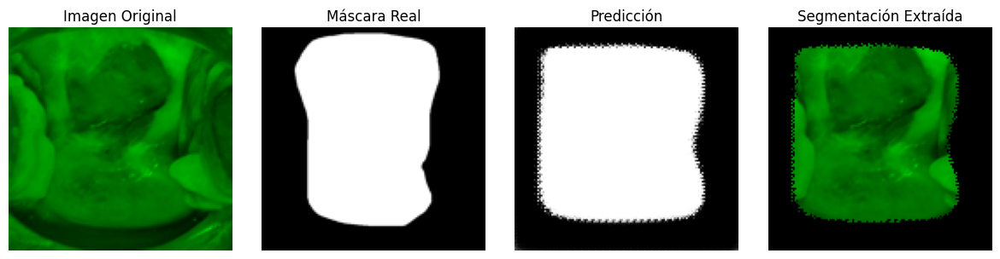

1/1 [==============================] - 0s 19ms/step


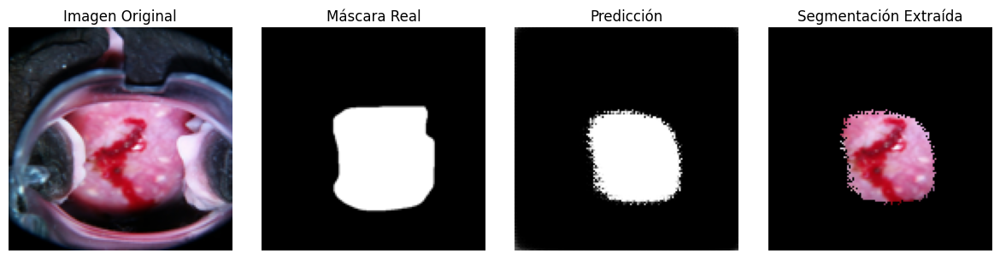

Epoch 19/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.44916633, shape=(), dtype=float32)
IoU: 0.44916632771492004
DICE: 0.6198961734771729
Epoch 20/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5207369, shape=(), dtype=float32)
IoU: 0.5207368731498718
DICE: 0.6848481297492981
Epoch 21/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5544308, shape=(), dtype=float32)
IoU: 0.5544307827949524
DICE: 0.7133553624153137

🔍 Visualización de muestras - Época 21
1/1 [==============================] - 0s 18ms/step


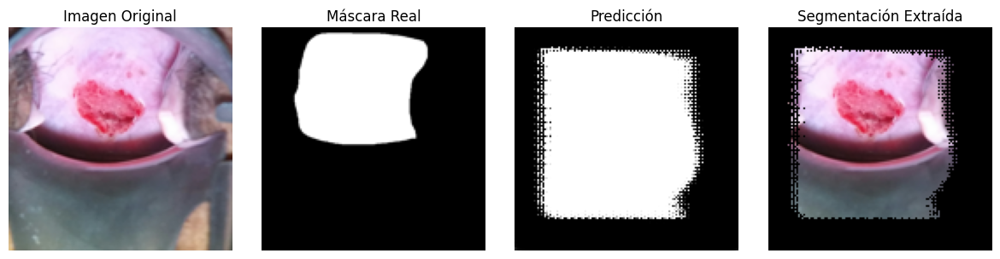

1/1 [==============================] - 0s 19ms/step


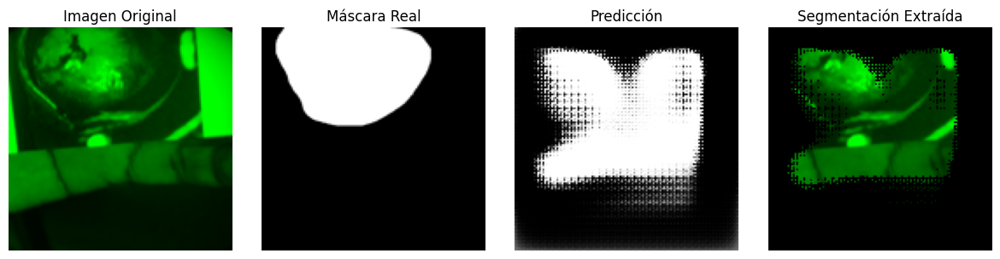

Epoch 22/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5722831, shape=(), dtype=float32)
IoU: 0.5722830891609192
DICE: 0.727964460849762
Epoch 23/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5835425, shape=(), dtype=float32)
IoU: 0.58354252576828
DICE: 0.7370089292526245
Epoch 24/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5804651, shape=(), dtype=float32)
IoU: 0.5804650783538818
DICE: 0.7345497012138367

🔍 Visualización de muestras - Época 24
1/1 [==============================] - 0s 19ms/step


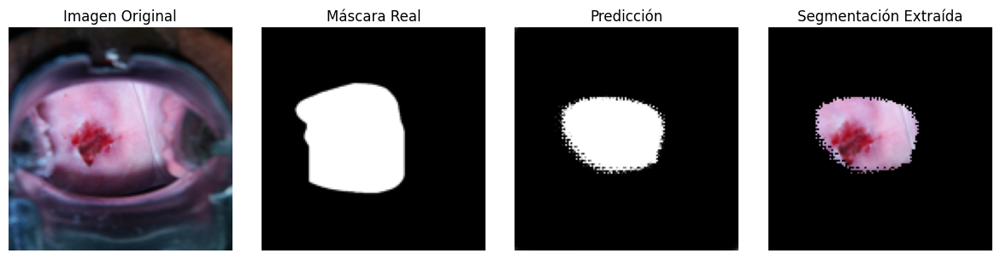

1/1 [==============================] - 0s 19ms/step


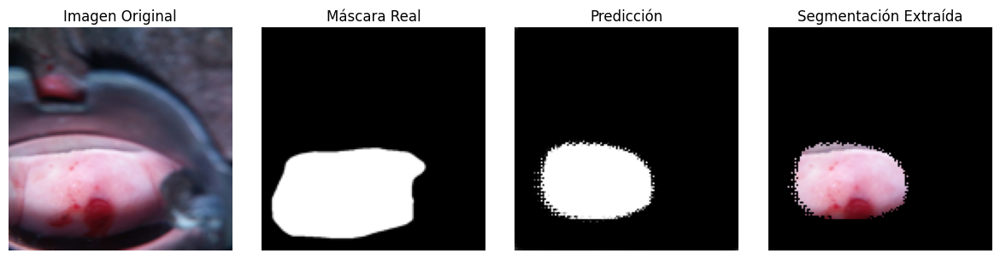

Epoch 25/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.59157985, shape=(), dtype=float32)
IoU: 0.5915798544883728
DICE: 0.74338698387146
Epoch 26/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.58875334, shape=(), dtype=float32)
IoU: 0.588753342628479
DICE: 0.7411513328552246
Epoch 27/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.58914006, shape=(), dtype=float32)
IoU: 0.5891400575637817
DICE: 0.7414577007293701

🔍 Visualización de muestras - Época 27
1/1 [==============================] - 0s 18ms/step


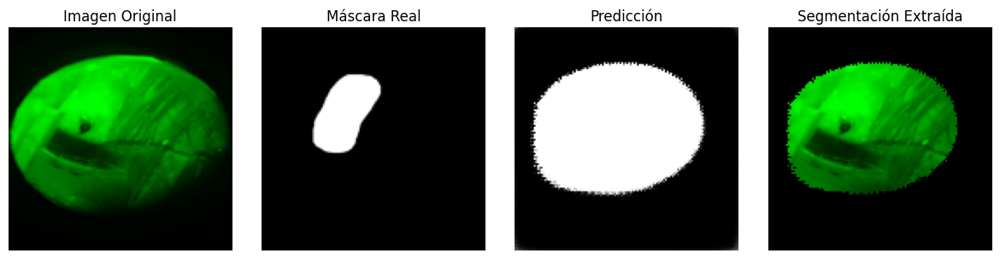

1/1 [==============================] - 0s 19ms/step


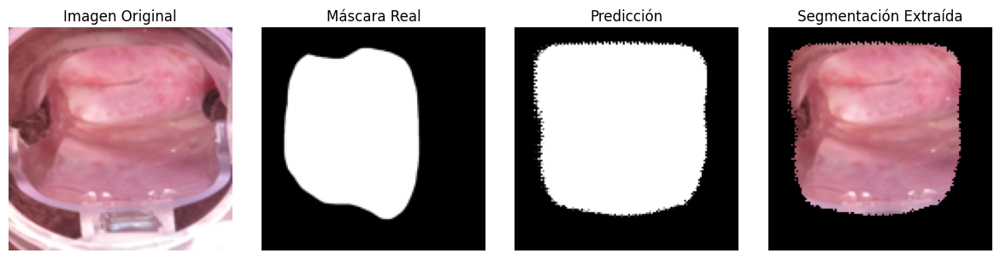

Epoch 28/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.57551706, shape=(), dtype=float32)
IoU: 0.5755170583724976
DICE: 0.730575442314148
Epoch 29/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5989654, shape=(), dtype=float32)
IoU: 0.5989654064178467
DICE: 0.749191164970398
Epoch 30/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5969823, shape=(), dtype=float32)
IoU: 0.5969823002815247
DICE: 0.747637927532196

🔍 Visualización de muestras - Época 30
1/1 [==============================] - 0s 18ms/step


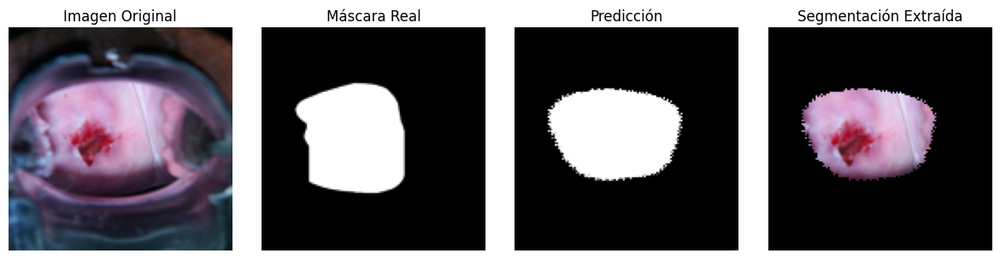

1/1 [==============================] - 0s 21ms/step


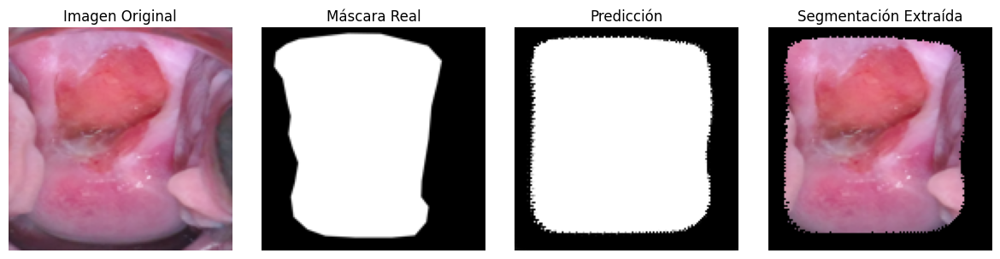

Epoch 31/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.58258754, shape=(), dtype=float32)
IoU: 0.5825875401496887
DICE: 0.7362468838691711
Epoch 32/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.603619, shape=(), dtype=float32)
IoU: 0.6036189794540405
DICE: 0.7528209686279297
Epoch 33/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6037473, shape=(), dtype=float32)
IoU: 0.6037473082542419
DICE: 0.7529207468032837

🔍 Visualización de muestras - Época 33
1/1 [==============================] - 0s 19ms/step


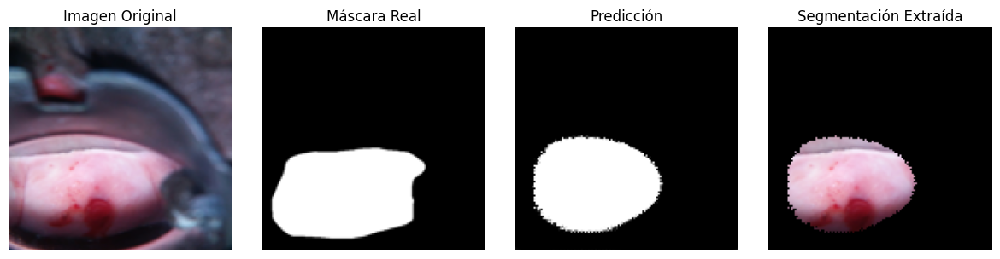

1/1 [==============================] - 0s 20ms/step


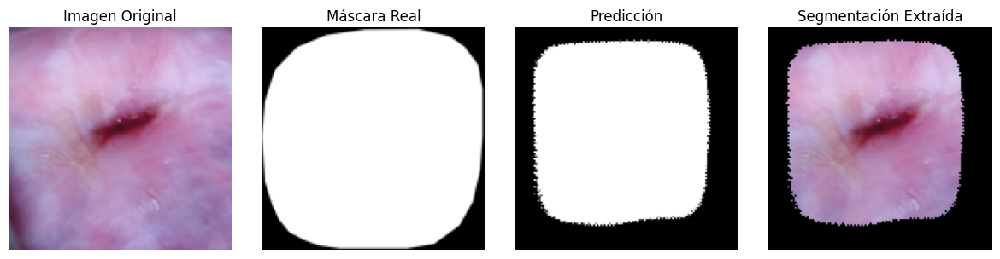

Epoch 34/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.605817, shape=(), dtype=float32)
IoU: 0.6058170199394226
DICE: 0.7545281052589417
Epoch 35/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5927837, shape=(), dtype=float32)
IoU: 0.5927836894989014
DICE: 0.744336724281311
Epoch 36/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5945357, shape=(), dtype=float32)
IoU: 0.5945357084274292
DICE: 0.745716392993927

🔍 Visualización de muestras - Época 36
1/1 [==============================] - 0s 18ms/step


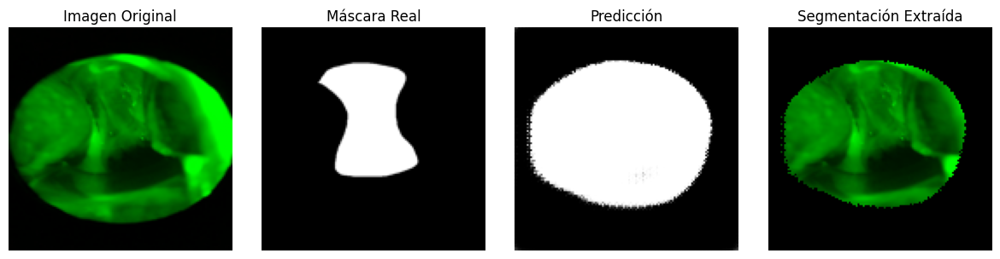

1/1 [==============================] - 0s 18ms/step


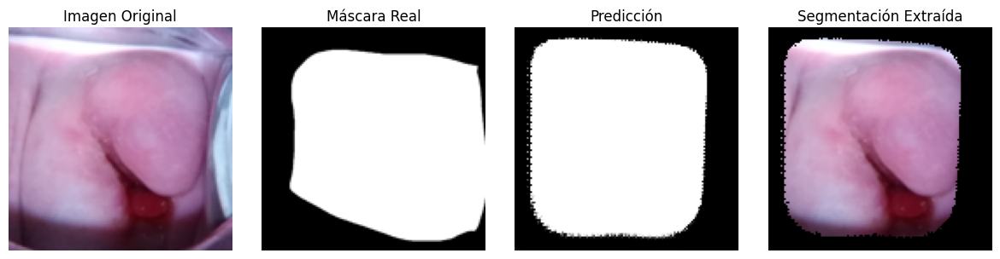

Epoch 37/150
2/2 [==============================] - 0s 4ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.595276, shape=(), dtype=float32)
IoU: 0.5952759981155396
DICE: 0.7462984323501587
Epoch 38/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.60549784, shape=(), dtype=float32)
IoU: 0.6054978370666504
DICE: 0.7542804479598999
Epoch 39/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.605151, shape=(), dtype=float32)
IoU: 0.6051509976387024
DICE: 0.754011332988739

🔍 Visualización de muestras - Época 39
1/1 [==============================] - 0s 18ms/step


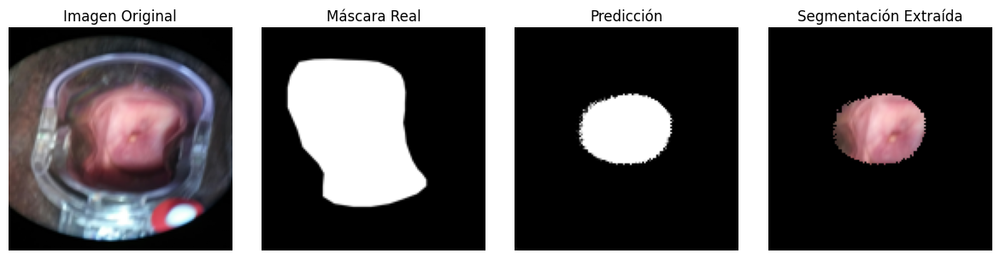

1/1 [==============================] - 0s 18ms/step


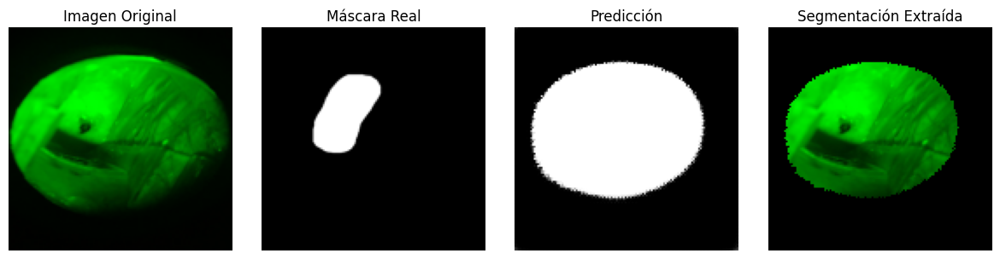

Epoch 40/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61150855, shape=(), dtype=float32)
IoU: 0.6115085482597351
DICE: 0.7589268684387207
Epoch 41/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6147073, shape=(), dtype=float32)
IoU: 0.6147072911262512
DICE: 0.761385440826416
Epoch 42/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61777294, shape=(), dtype=float32)
IoU: 0.6177729368209839
DICE: 0.7637325525283813

🔍 Visualización de muestras - Época 42
1/1 [==============================] - 0s 18ms/step


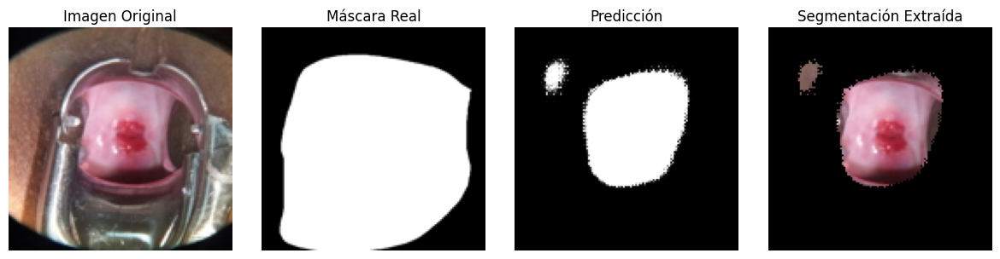

1/1 [==============================] - 0s 19ms/step


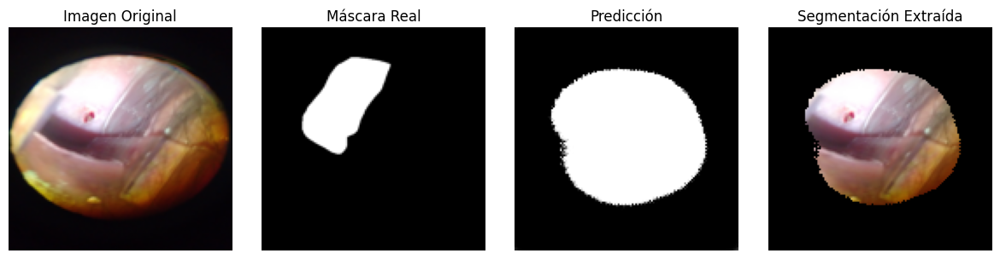

Epoch 43/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61022556, shape=(), dtype=float32)
IoU: 0.6102255582809448
DICE: 0.7579379677772522
Epoch 44/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.60958946, shape=(), dtype=float32)
IoU: 0.6095894575119019
DICE: 0.7574471235275269
Epoch 45/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5851681, shape=(), dtype=float32)
IoU: 0.5851681232452393
DICE: 0.7383041381835938

🔍 Visualización de muestras - Época 45
1/1 [==============================] - 0s 22ms/step


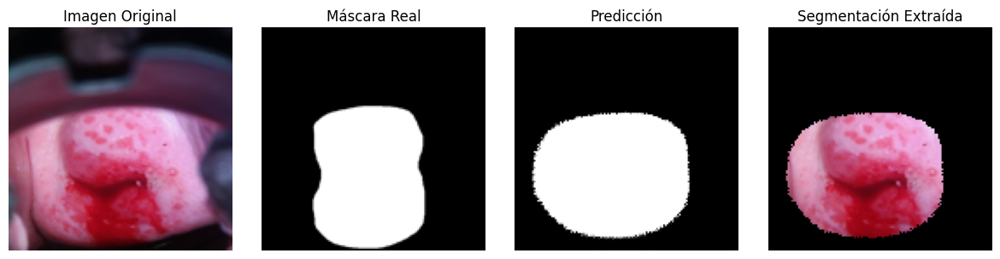

1/1 [==============================] - 0s 19ms/step


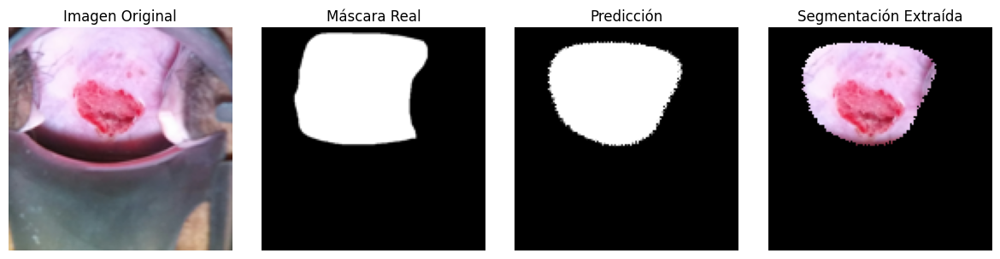

Epoch 46/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61823016, shape=(), dtype=float32)
IoU: 0.6182301640510559
DICE: 0.7640818953514099
Epoch 47/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6162592, shape=(), dtype=float32)
IoU: 0.6162592172622681
DICE: 0.7625747323036194
Epoch 48/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61674964, shape=(), dtype=float32)
IoU: 0.61674964427948
DICE: 0.76295006275177

🔍 Visualización de muestras - Época 48
1/1 [==============================] - 0s 18ms/step


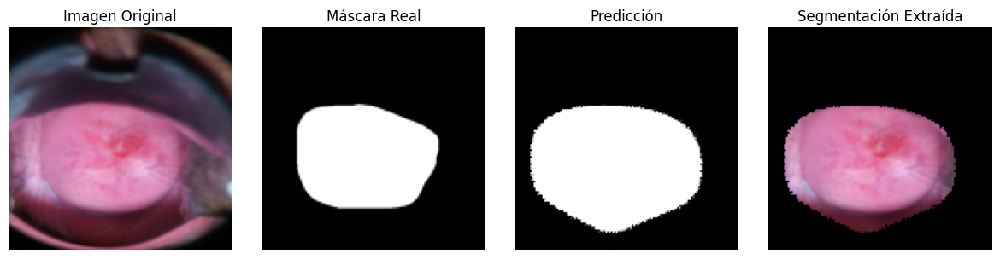

1/1 [==============================] - 0s 19ms/step


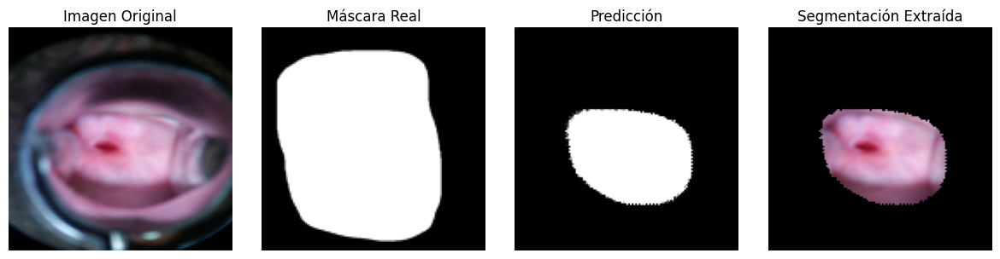

Epoch 49/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6139618, shape=(), dtype=float32)
IoU: 0.6139618158340454
DICE: 0.760813295841217
Epoch 50/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62126565, shape=(), dtype=float32)
IoU: 0.6212656497955322
DICE: 0.7663958668708801
Epoch 51/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6198999, shape=(), dtype=float32)
IoU: 0.6198999285697937
DICE: 0.7653558254241943

🔍 Visualización de muestras - Época 51
1/1 [==============================] - 0s 19ms/step


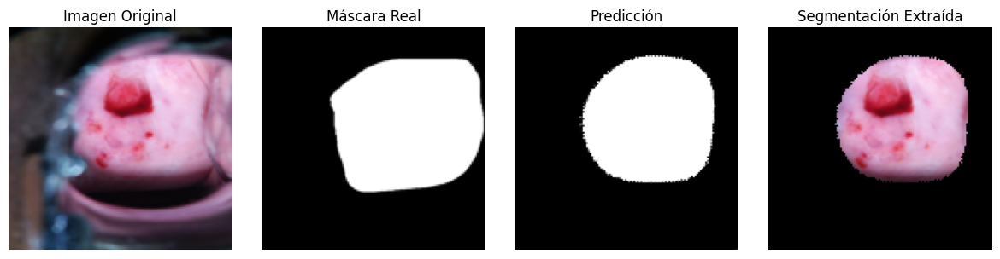

1/1 [==============================] - 0s 19ms/step


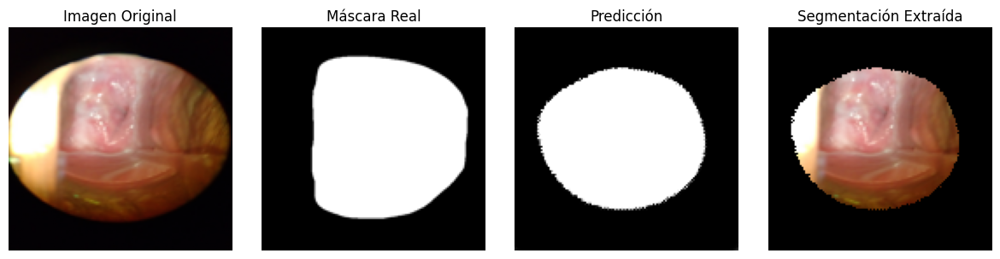

Epoch 52/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6195411, shape=(), dtype=float32)
IoU: 0.6195411086082458
DICE: 0.7650822997093201
Epoch 53/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6215682, shape=(), dtype=float32)
IoU: 0.6215682029724121
DICE: 0.7666260600090027
Epoch 54/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62289906, shape=(), dtype=float32)
IoU: 0.622899055480957
DICE: 0.7676374316215515

🔍 Visualización de muestras - Época 54
1/1 [==============================] - 0s 18ms/step


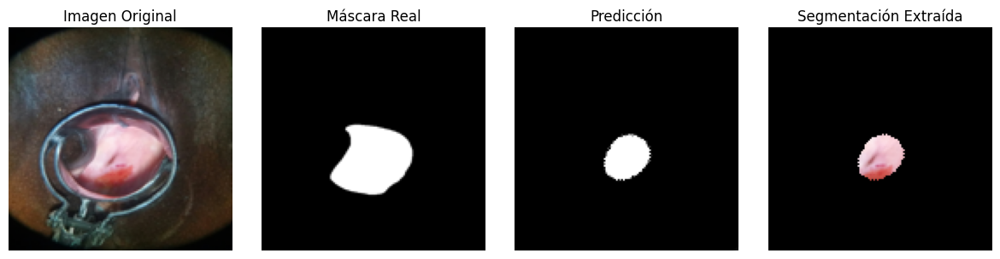

1/1 [==============================] - 0s 19ms/step


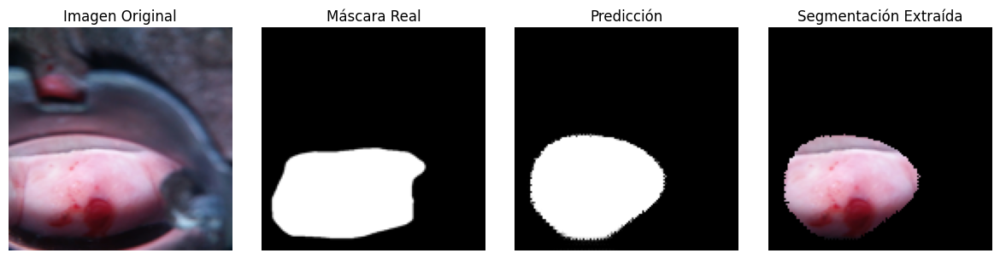

Epoch 55/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6173296, shape=(), dtype=float32)
IoU: 0.6173295974731445
DICE: 0.7633937001228333
Epoch 56/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6144682, shape=(), dtype=float32)
IoU: 0.6144682168960571
DICE: 0.7612019777297974
Epoch 57/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6076407, shape=(), dtype=float32)
IoU: 0.6076406836509705
DICE: 0.7559409141540527

🔍 Visualización de muestras - Época 57
1/1 [==============================] - 0s 20ms/step


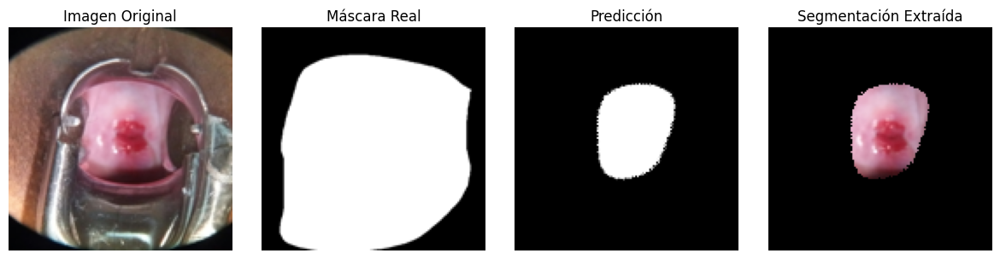

1/1 [==============================] - 0s 18ms/step


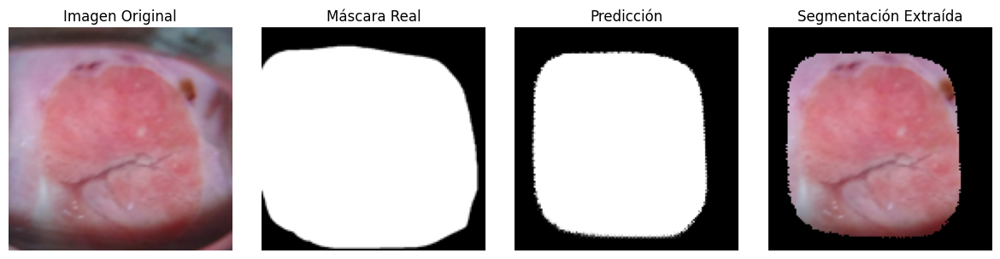

Epoch 58/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6221573, shape=(), dtype=float32)
IoU: 0.6221572756767273
DICE: 0.767073929309845
Epoch 59/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6224292, shape=(), dtype=float32)
IoU: 0.6224291920661926
DICE: 0.7672805786132812
Epoch 60/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.619389, shape=(), dtype=float32)
IoU: 0.619388997554779
DICE: 0.7649662494659424

🔍 Visualización de muestras - Época 60
1/1 [==============================] - 0s 19ms/step


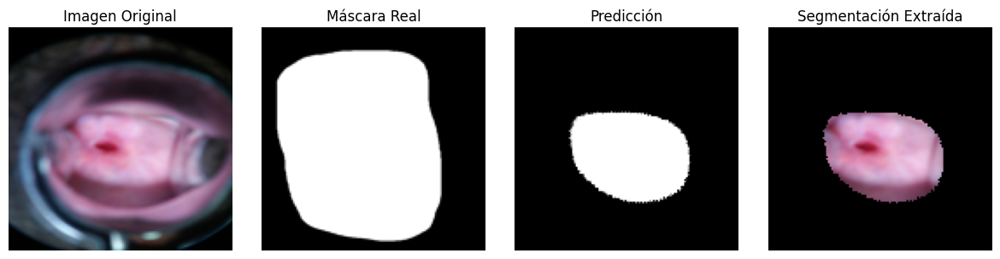

1/1 [==============================] - 0s 20ms/step


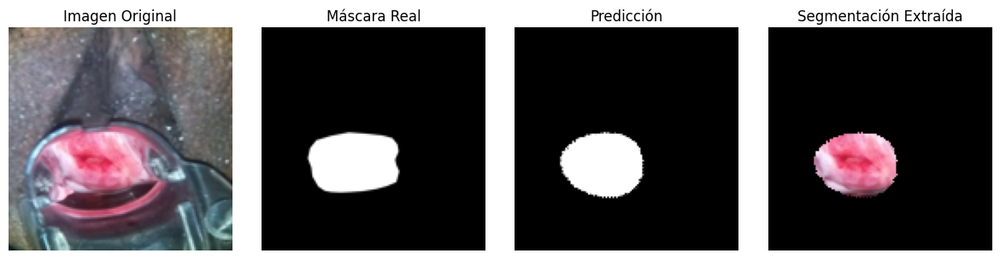

Epoch 61/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62452614, shape=(), dtype=float32)
IoU: 0.6245261430740356
DICE: 0.7688717842102051
Epoch 62/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6223998, shape=(), dtype=float32)
IoU: 0.6223998069763184
DICE: 0.7672582268714905
Epoch 63/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6141387, shape=(), dtype=float32)
IoU: 0.6141387224197388
DICE: 0.7609491348266602

🔍 Visualización de muestras - Época 63
1/1 [==============================] - 0s 19ms/step


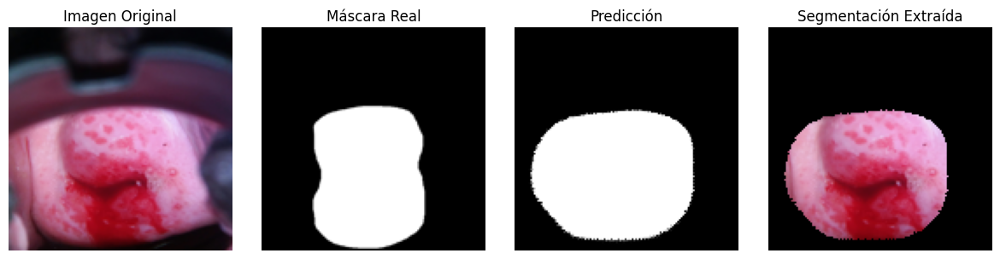

1/1 [==============================] - 0s 19ms/step


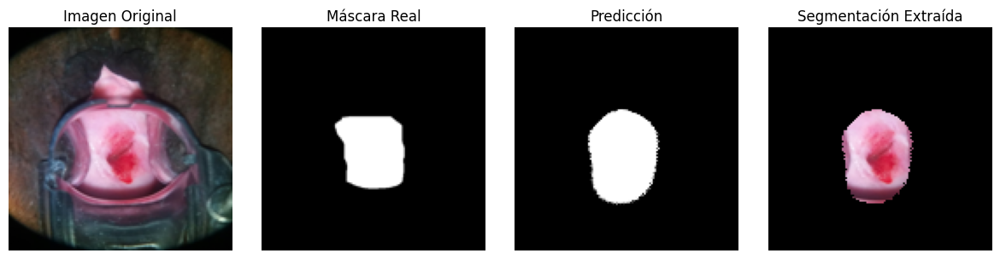

Epoch 64/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.620983, shape=(), dtype=float32)
IoU: 0.6209830045700073
DICE: 0.7661807537078857
Epoch 65/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6027688, shape=(), dtype=float32)
IoU: 0.6027687788009644
DICE: 0.7521593570709229
Epoch 66/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6147917, shape=(), dtype=float32)
IoU: 0.6147916913032532
DICE: 0.7614501714706421

🔍 Visualización de muestras - Época 66
1/1 [==============================] - 0s 19ms/step


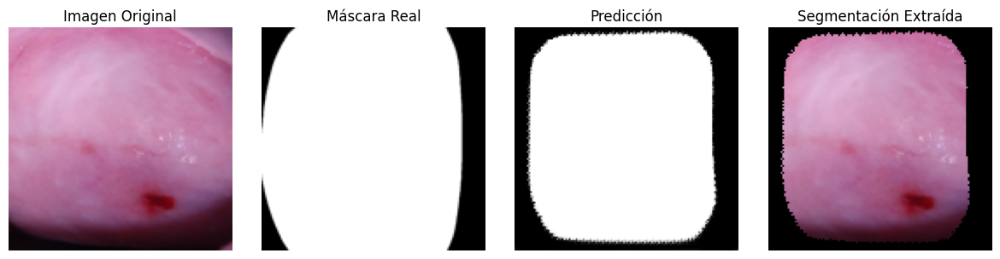

1/1 [==============================] - 0s 19ms/step


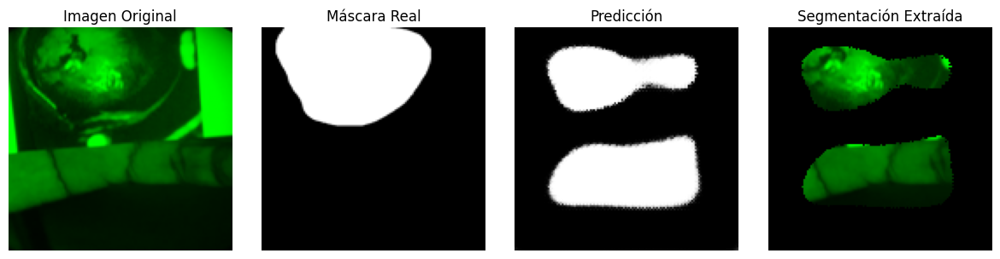

Epoch 67/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62267584, shape=(), dtype=float32)
IoU: 0.6226758360862732
DICE: 0.7674679160118103
Epoch 68/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6154458, shape=(), dtype=float32)
IoU: 0.6154457926750183
DICE: 0.7619516253471375
Epoch 69/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6232896, shape=(), dtype=float32)
IoU: 0.6232895851135254
DICE: 0.7679339051246643

🔍 Visualización de muestras - Época 69
1/1 [==============================] - 0s 18ms/step


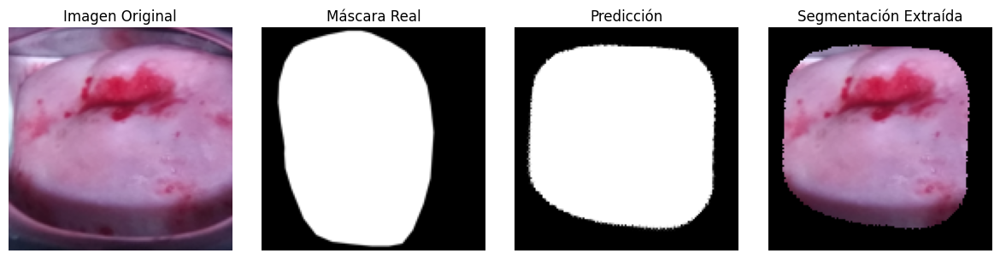

1/1 [==============================] - 0s 20ms/step


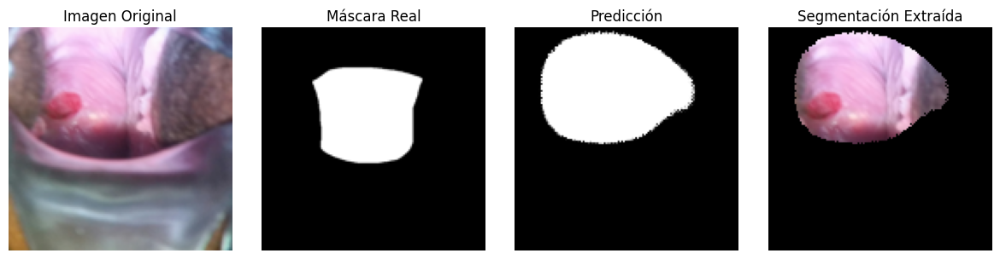

Epoch 70/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.60387045, shape=(), dtype=float32)
IoU: 0.6038704514503479
DICE: 0.753016471862793
Epoch 71/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.618356, shape=(), dtype=float32)
IoU: 0.6183559894561768
DICE: 0.7641779780387878
Epoch 72/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6195123, shape=(), dtype=float32)
IoU: 0.6195123195648193
DICE: 0.765060305595398

🔍 Visualización de muestras - Época 72
1/1 [==============================] - 0s 18ms/step


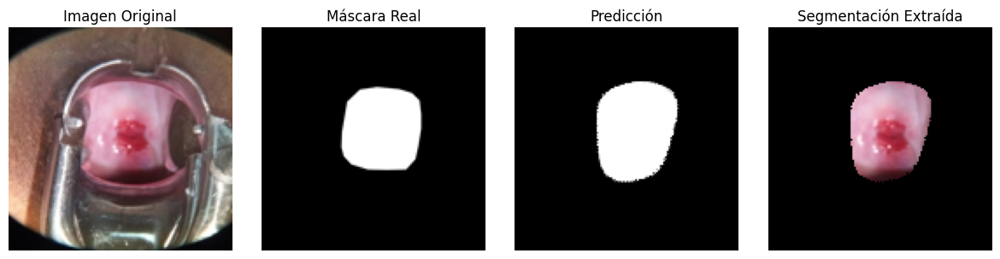

1/1 [==============================] - 0s 19ms/step


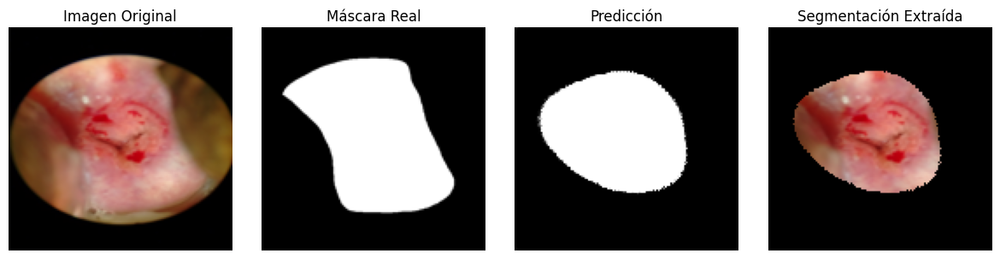

Epoch 73/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61866474, shape=(), dtype=float32)
IoU: 0.6186647415161133
DICE: 0.7644136548042297
Epoch 74/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6224243, shape=(), dtype=float32)
IoU: 0.622424304485321
DICE: 0.7672768235206604
Epoch 75/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6265142, shape=(), dtype=float32)
IoU: 0.626514196395874
DICE: 0.7703765630722046

🔍 Visualización de muestras - Época 75
1/1 [==============================] - 0s 18ms/step


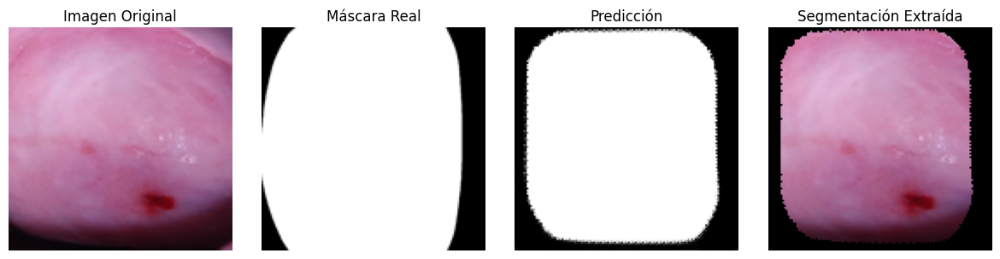

1/1 [==============================] - 0s 18ms/step


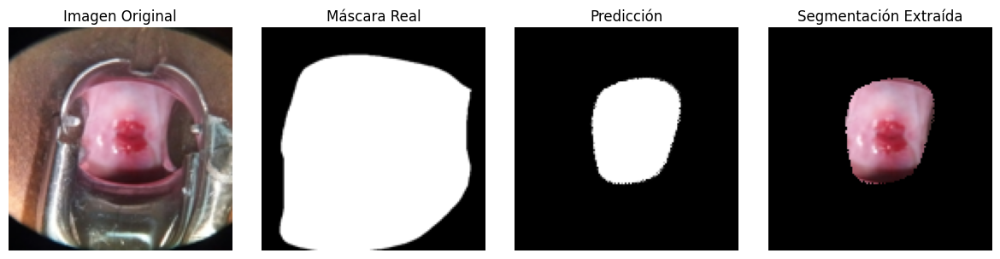

Epoch 76/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62591535, shape=(), dtype=float32)
IoU: 0.6259153485298157
DICE: 0.7699236273765564
Epoch 77/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6137393, shape=(), dtype=float32)
IoU: 0.6137393116950989
DICE: 0.760642409324646
Epoch 78/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6216313, shape=(), dtype=float32)
IoU: 0.6216313242912292
DICE: 0.7666740417480469

🔍 Visualización de muestras - Época 78
1/1 [==============================] - 0s 19ms/step


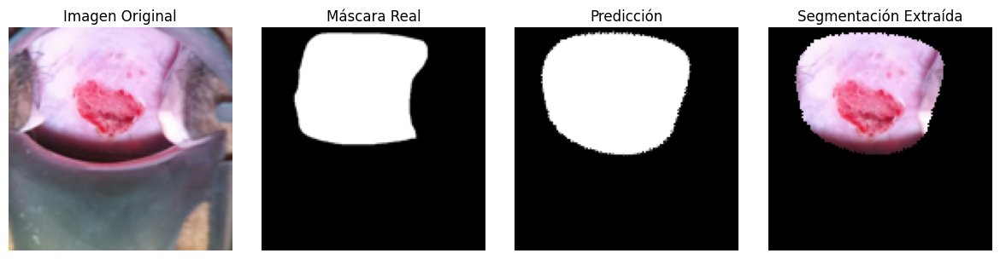

1/1 [==============================] - 0s 19ms/step


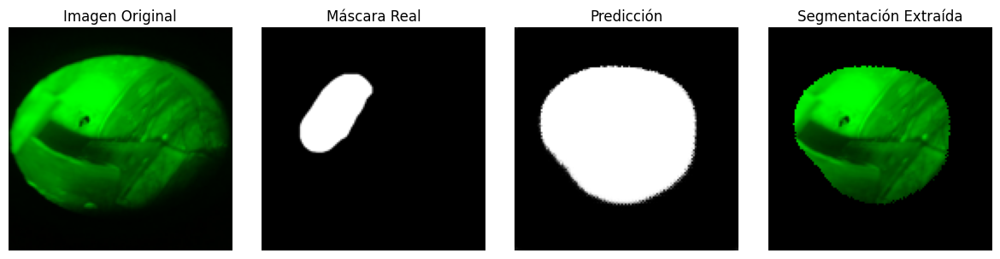

Epoch 79/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62630737, shape=(), dtype=float32)
IoU: 0.6263073682785034
DICE: 0.770220160484314
Epoch 80/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61644346, shape=(), dtype=float32)
IoU: 0.6164434552192688
DICE: 0.762715756893158
Epoch 81/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.60615015, shape=(), dtype=float32)
IoU: 0.6061501502990723
DICE: 0.7547864317893982

🔍 Visualización de muestras - Época 81
1/1 [==============================] - 0s 18ms/step


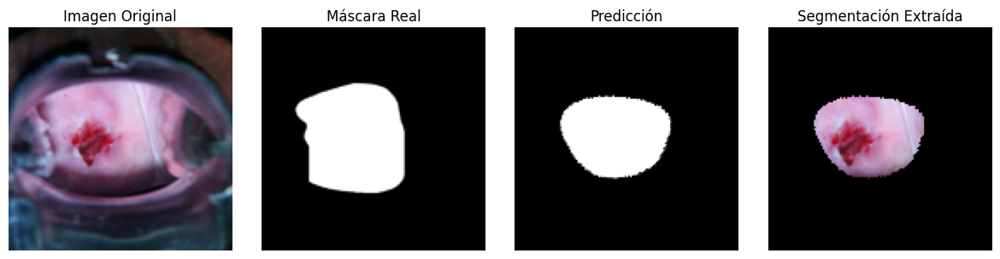

1/1 [==============================] - 0s 18ms/step


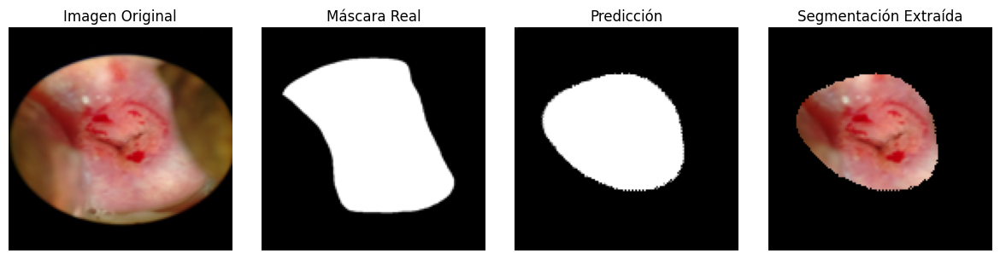

Epoch 82/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.60129637, shape=(), dtype=float32)
IoU: 0.6012963652610779
DICE: 0.7510119676589966
Epoch 83/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.612547, shape=(), dtype=float32)
IoU: 0.612546980381012
DICE: 0.7597260475158691
Epoch 84/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6171689, shape=(), dtype=float32)
IoU: 0.6171689033508301
DICE: 0.7632707953453064

🔍 Visualización de muestras - Época 84
1/1 [==============================] - 0s 19ms/step


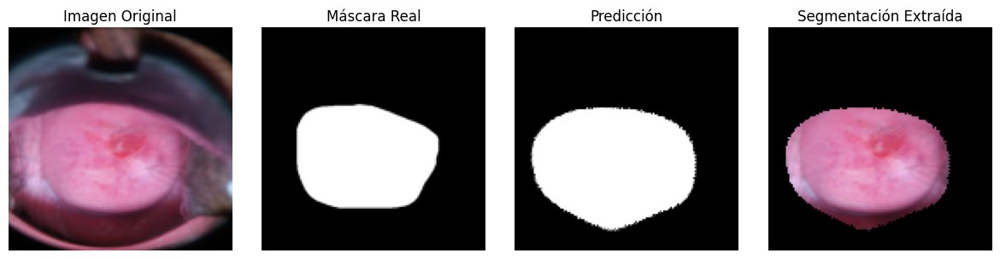

1/1 [==============================] - 0s 19ms/step


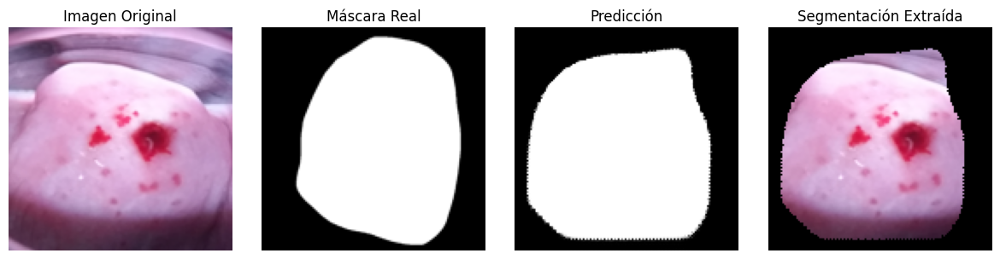

Epoch 85/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6231967, shape=(), dtype=float32)
IoU: 0.6231967210769653
DICE: 0.7678634524345398
Epoch 86/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6083621, shape=(), dtype=float32)
IoU: 0.608362078666687
DICE: 0.7564989328384399
Epoch 87/150
2/2 [==============================] - 0s 4ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62699395, shape=(), dtype=float32)
IoU: 0.6269939541816711
DICE: 0.7707391381263733

🔍 Visualización de muestras - Época 87
1/1 [==============================] - 0s 20ms/step


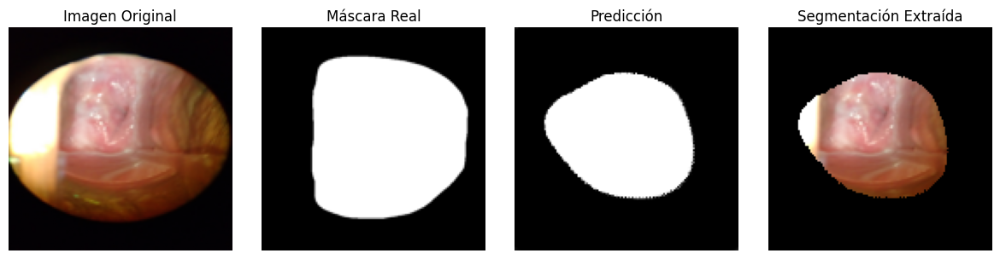

1/1 [==============================] - 0s 19ms/step


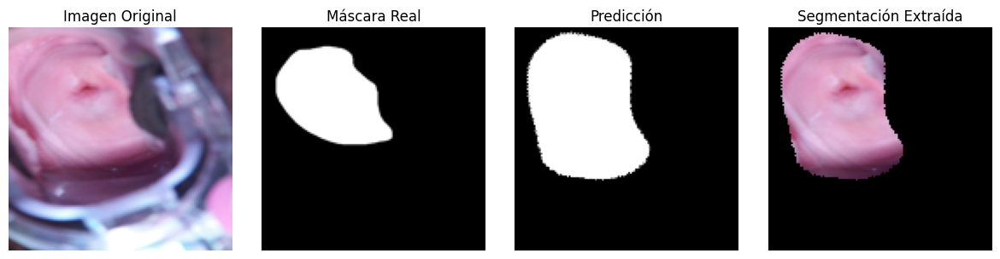

Epoch 88/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62805086, shape=(), dtype=float32)
IoU: 0.6280508637428284
DICE: 0.7715371251106262
Epoch 89/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6286087, shape=(), dtype=float32)
IoU: 0.6286087036132812
DICE: 0.7719579339027405
Epoch 90/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6276821, shape=(), dtype=float32)
IoU: 0.627682089805603
DICE: 0.7712588310241699

🔍 Visualización de muestras - Época 90
1/1 [==============================] - 0s 19ms/step


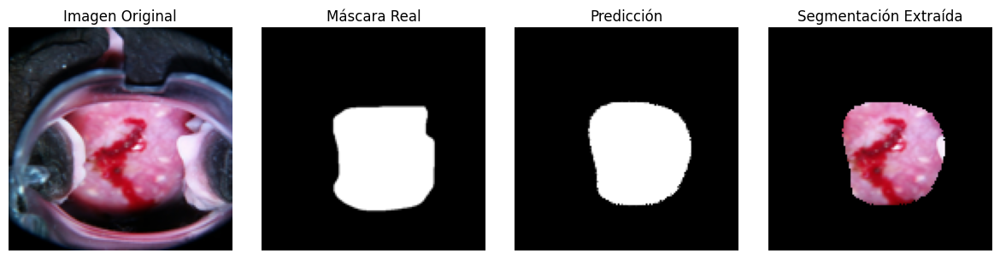

1/1 [==============================] - 0s 19ms/step


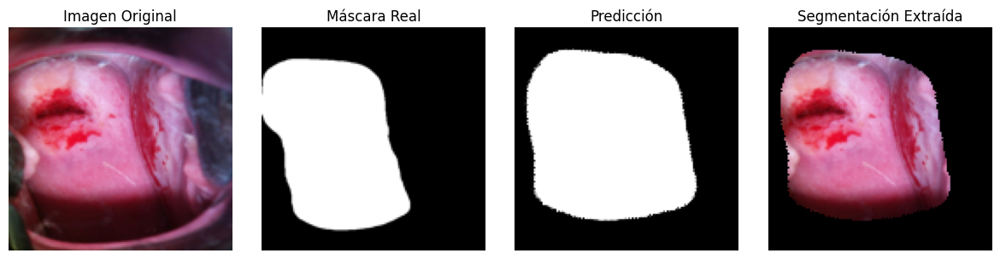

Epoch 91/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.5750674, shape=(), dtype=float32)
IoU: 0.575067400932312
DICE: 0.7302131056785583
Epoch 92/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.60373557, shape=(), dtype=float32)
IoU: 0.6037355661392212
DICE: 0.7529115676879883
Epoch 93/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.60456043, shape=(), dtype=float32)
IoU: 0.6045604348182678
DICE: 0.7535527348518372

🔍 Visualización de muestras - Época 93
1/1 [==============================] - 0s 19ms/step


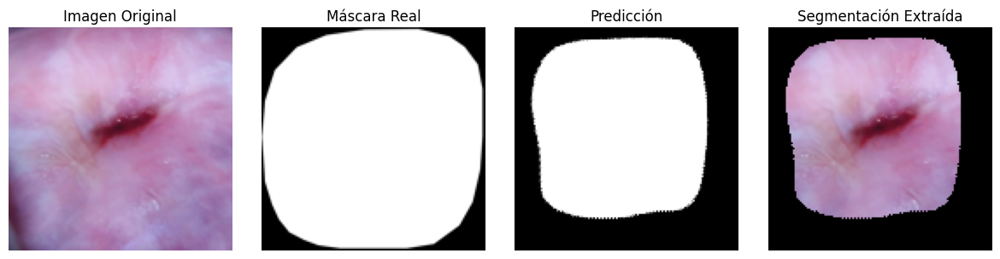

1/1 [==============================] - 0s 19ms/step


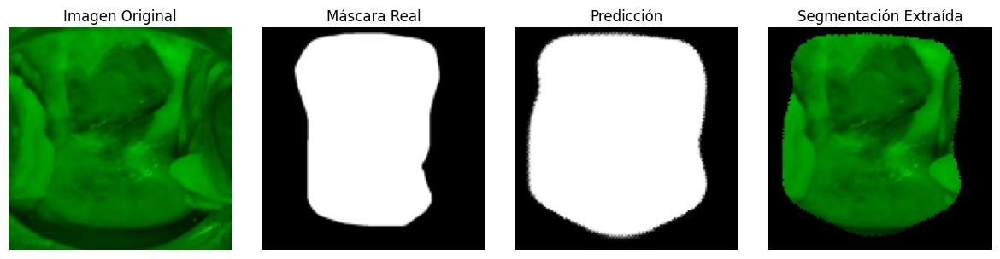

Epoch 94/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62690955, shape=(), dtype=float32)
IoU: 0.6269095540046692
DICE: 0.7706753611564636
Epoch 95/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62240636, shape=(), dtype=float32)
IoU: 0.6224063634872437
DICE: 0.7672631740570068
Epoch 96/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63144803, shape=(), dtype=float32)
IoU: 0.6314480304718018
DICE: 0.7740951776504517

🔍 Visualización de muestras - Época 96
1/1 [==============================] - 0s 19ms/step


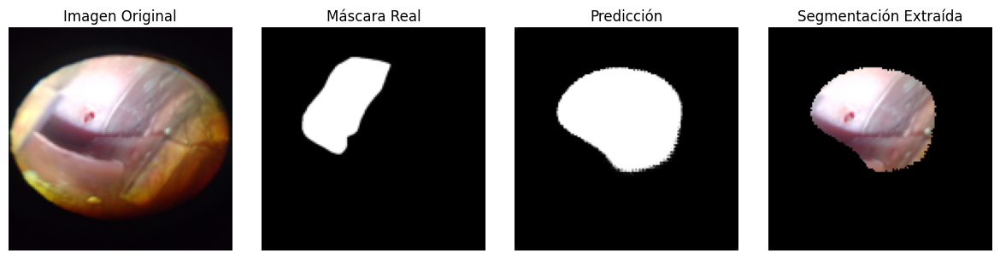

1/1 [==============================] - 0s 19ms/step


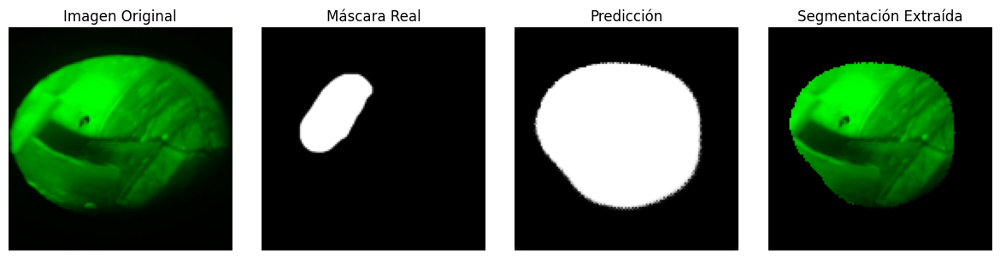

Epoch 97/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6277946, shape=(), dtype=float32)
IoU: 0.627794623374939
DICE: 0.7713437676429749
Epoch 98/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61883605, shape=(), dtype=float32)
IoU: 0.6188360452651978
DICE: 0.7645444273948669
Epoch 99/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6278848, shape=(), dtype=float32)
IoU: 0.6278848052024841
DICE: 0.7714118361473083

🔍 Visualización de muestras - Época 99
1/1 [==============================] - 0s 19ms/step


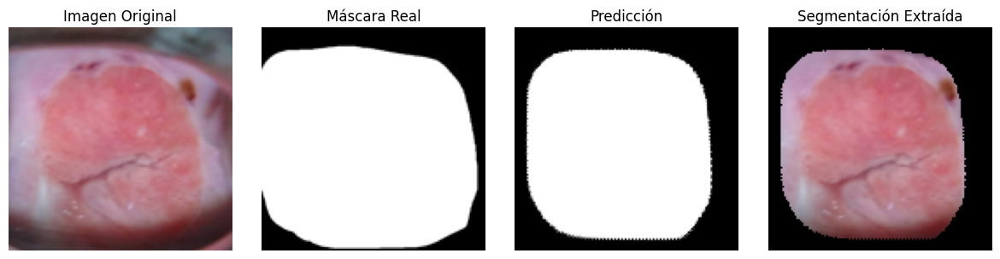

1/1 [==============================] - 0s 19ms/step


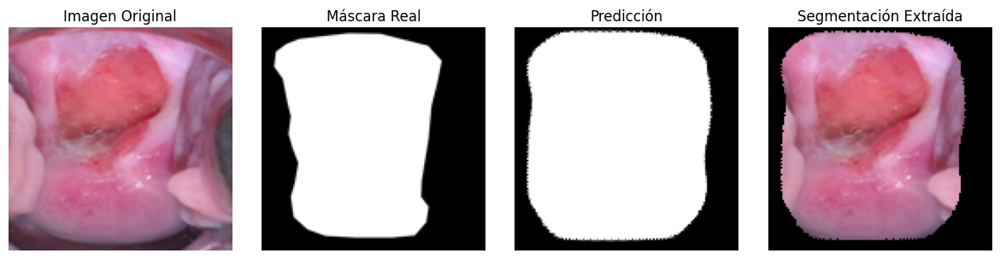

Epoch 100/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61514395, shape=(), dtype=float32)
IoU: 0.6151439547538757
DICE: 0.7617202997207642
Epoch 101/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63097614, shape=(), dtype=float32)
IoU: 0.630976140499115
DICE: 0.7737404704093933
Epoch 102/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63219064, shape=(), dtype=float32)
IoU: 0.6321906447410583
DICE: 0.7746529579162598

🔍 Visualización de muestras - Época 102
1/1 [==============================] - 0s 19ms/step


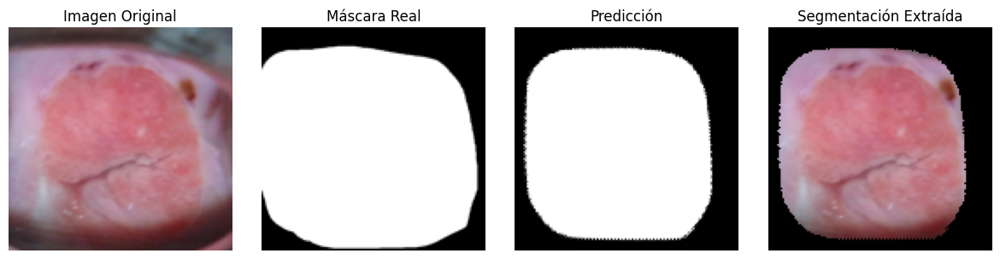

1/1 [==============================] - 0s 19ms/step


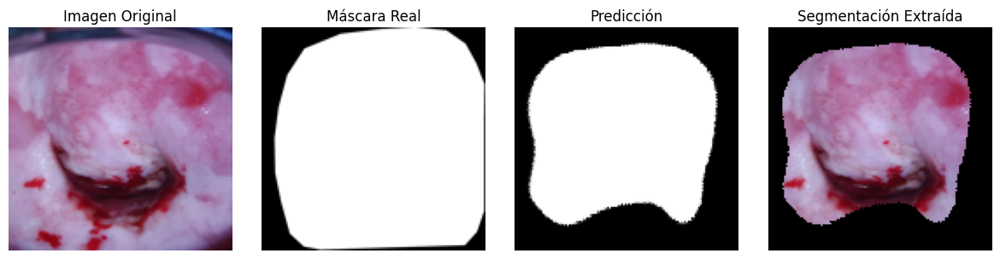

Epoch 103/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6316479, shape=(), dtype=float32)
IoU: 0.6316478848457336
DICE: 0.7742453217506409
Epoch 104/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62691, shape=(), dtype=float32)
IoU: 0.6269099712371826
DICE: 0.7706756591796875
Epoch 105/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6287654, shape=(), dtype=float32)
IoU: 0.6287654042243958
DICE: 0.7720760703086853

🔍 Visualización de muestras - Época 105
1/1 [==============================] - 0s 18ms/step


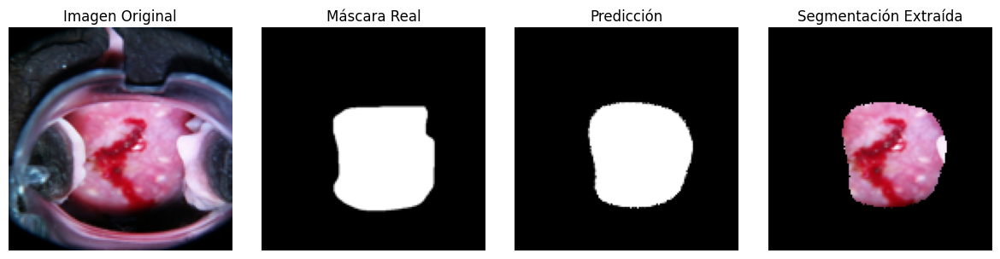

1/1 [==============================] - 0s 18ms/step


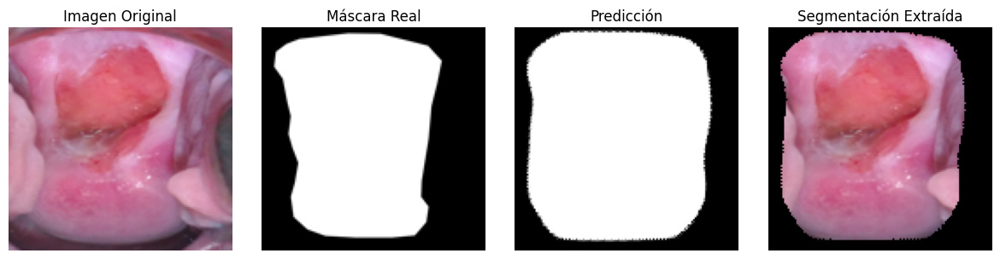

Epoch 106/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6211008, shape=(), dtype=float32)
IoU: 0.6211007833480835
DICE: 0.7662703990936279
Epoch 107/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6313044, shape=(), dtype=float32)
IoU: 0.6313043832778931
DICE: 0.7739872336387634
Epoch 108/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6237139, shape=(), dtype=float32)
IoU: 0.6237139105796814
DICE: 0.768255889415741

🔍 Visualización de muestras - Época 108
1/1 [==============================] - 0s 18ms/step


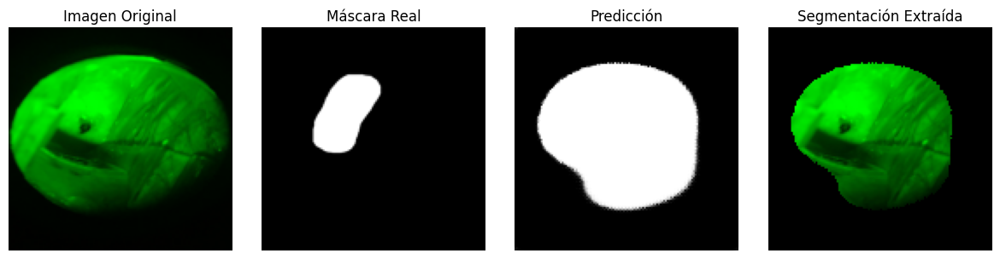

1/1 [==============================] - 0s 18ms/step


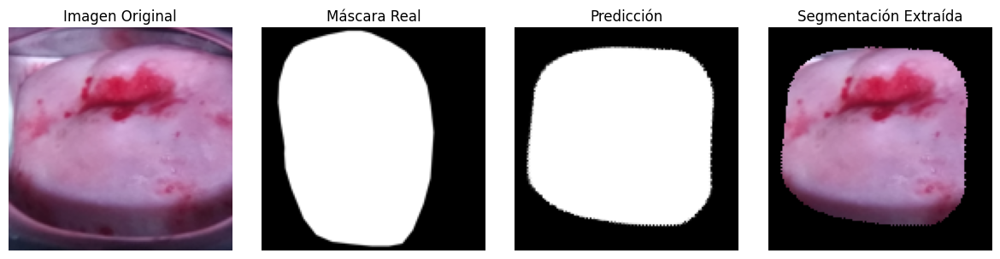

Epoch 109/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61915934, shape=(), dtype=float32)
IoU: 0.6191593408584595
DICE: 0.7647911310195923
Epoch 110/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6318115, shape=(), dtype=float32)
IoU: 0.6318114995956421
DICE: 0.7743682265281677
Epoch 111/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6334618, shape=(), dtype=float32)
IoU: 0.6334617733955383
DICE: 0.7756065130233765

🔍 Visualización de muestras - Época 111
1/1 [==============================] - 0s 19ms/step


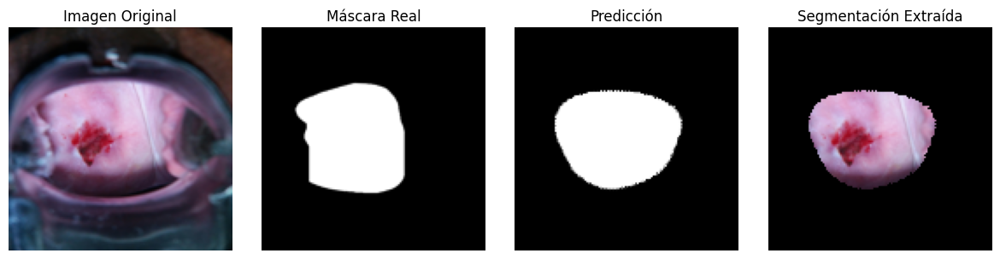

1/1 [==============================] - 0s 19ms/step


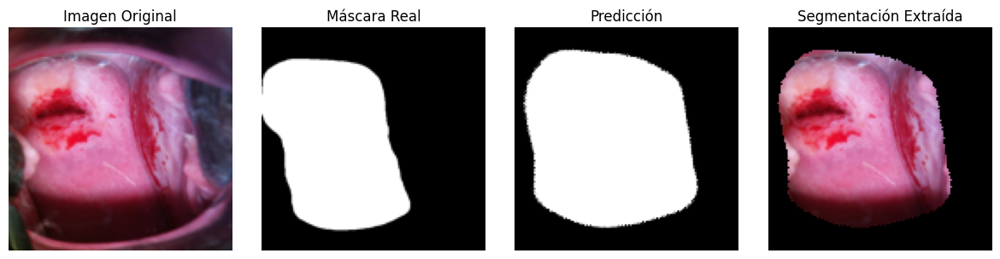

Epoch 112/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6292384, shape=(), dtype=float32)
IoU: 0.6292384266853333
DICE: 0.7724326252937317
Epoch 113/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63357407, shape=(), dtype=float32)
IoU: 0.6335740685462952
DICE: 0.7756906747817993
Epoch 114/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62924075, shape=(), dtype=float32)
IoU: 0.6292407512664795
DICE: 0.7724343538284302

🔍 Visualización de muestras - Época 114
1/1 [==============================] - 0s 19ms/step


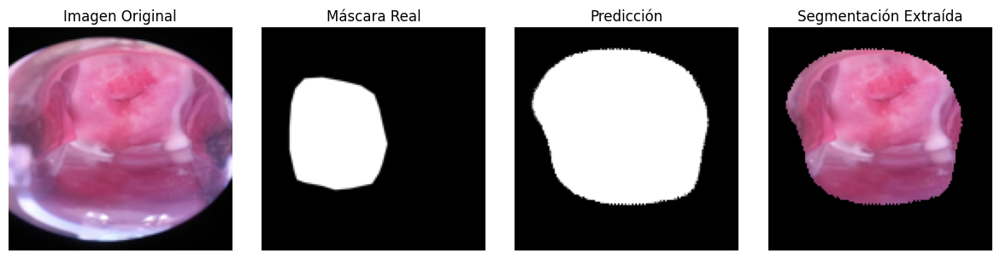

1/1 [==============================] - 0s 19ms/step


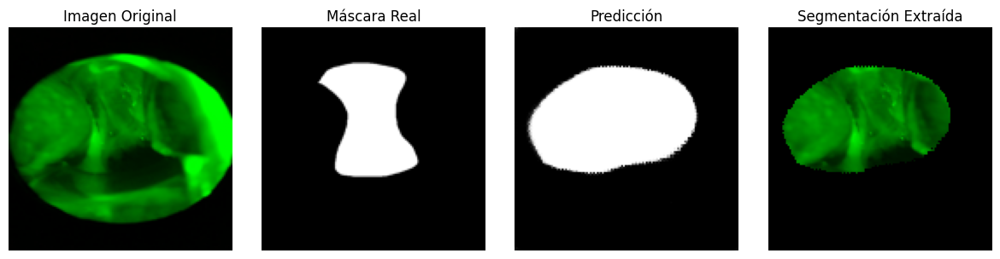

Epoch 115/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.633437, shape=(), dtype=float32)
IoU: 0.6334369778633118
DICE: 0.7755879163742065
Epoch 116/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.631825, shape=(), dtype=float32)
IoU: 0.6318249702453613
DICE: 0.7743783593177795
Epoch 117/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63682836, shape=(), dtype=float32)
IoU: 0.6368283629417419
DICE: 0.7781248092651367

🔍 Visualización de muestras - Época 117
1/1 [==============================] - 0s 19ms/step


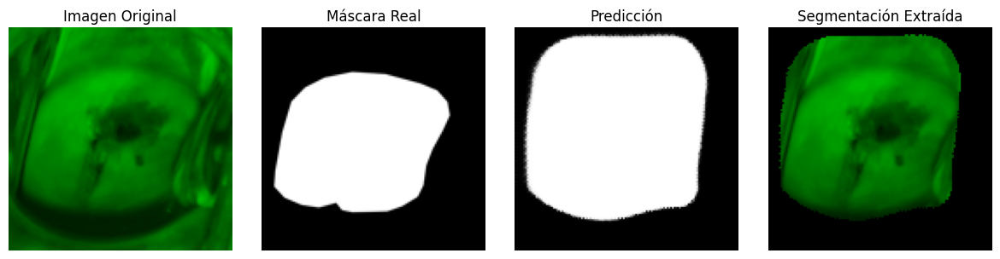

1/1 [==============================] - 0s 18ms/step


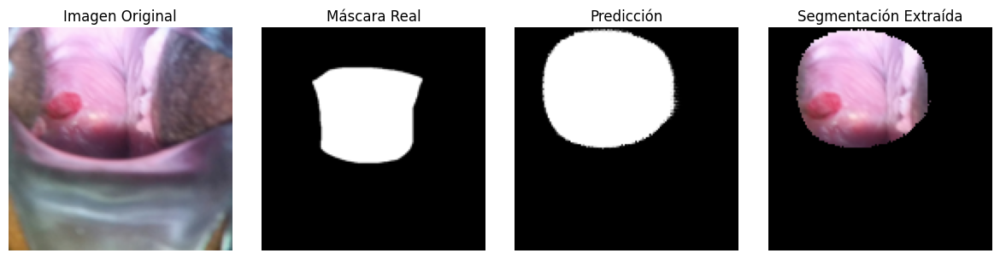

Epoch 118/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63527125, shape=(), dtype=float32)
IoU: 0.6352712512016296
DICE: 0.7769612669944763
Epoch 119/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6281141, shape=(), dtype=float32)
IoU: 0.6281141042709351
DICE: 0.7715848684310913
Epoch 120/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6360719, shape=(), dtype=float32)
IoU: 0.6360719203948975
DICE: 0.7775598764419556

🔍 Visualización de muestras - Época 120
1/1 [==============================] - 0s 19ms/step


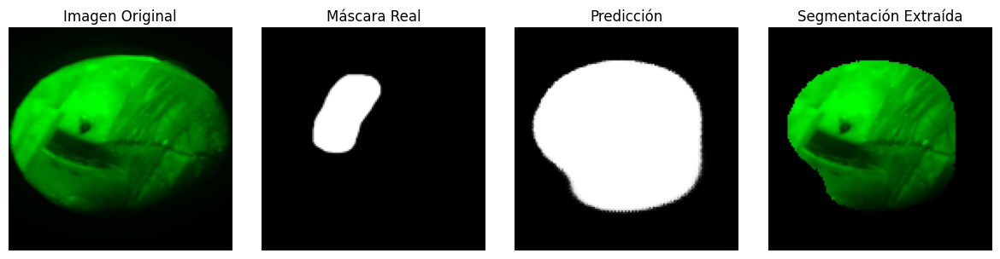

1/1 [==============================] - 0s 19ms/step


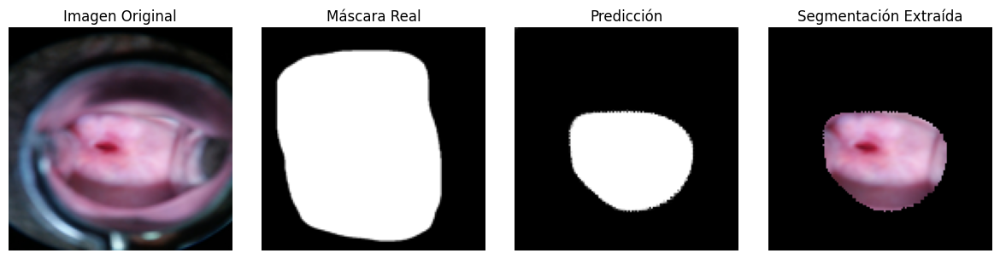

Epoch 121/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6319434, shape=(), dtype=float32)
IoU: 0.63194340467453
DICE: 0.7744672894477844
Epoch 122/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63013196, shape=(), dtype=float32)
IoU: 0.6301319599151611
DICE: 0.7731054425239563
Epoch 123/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6320316, shape=(), dtype=float32)
IoU: 0.6320316195487976
DICE: 0.7745335698127747

🔍 Visualización de muestras - Época 123
1/1 [==============================] - 0s 18ms/step


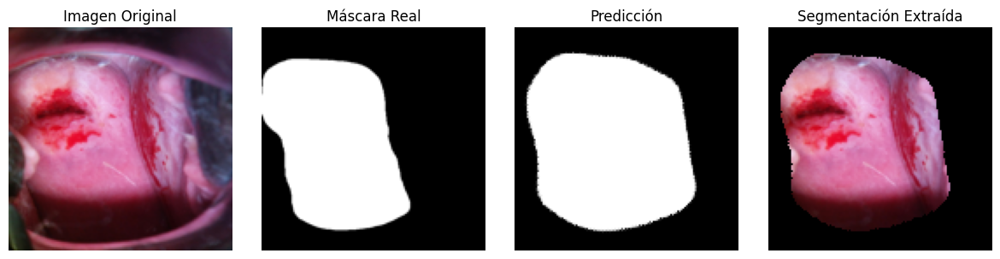

1/1 [==============================] - 0s 19ms/step


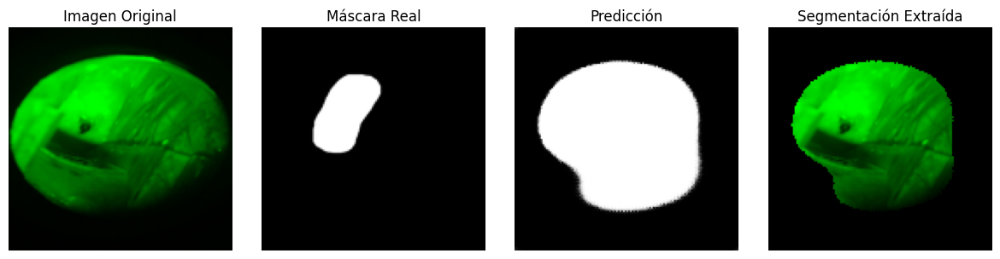

Epoch 124/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6358084, shape=(), dtype=float32)
IoU: 0.6358084082603455
DICE: 0.7773628830909729
Epoch 125/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6297428, shape=(), dtype=float32)
IoU: 0.6297428011894226
DICE: 0.7728124856948853
Epoch 126/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63159674, shape=(), dtype=float32)
IoU: 0.6315967440605164
DICE: 0.7742069363594055

🔍 Visualización de muestras - Época 126
1/1 [==============================] - 0s 20ms/step


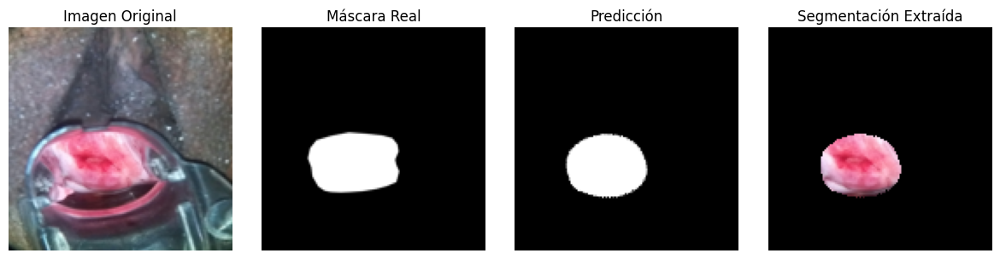

1/1 [==============================] - 0s 19ms/step


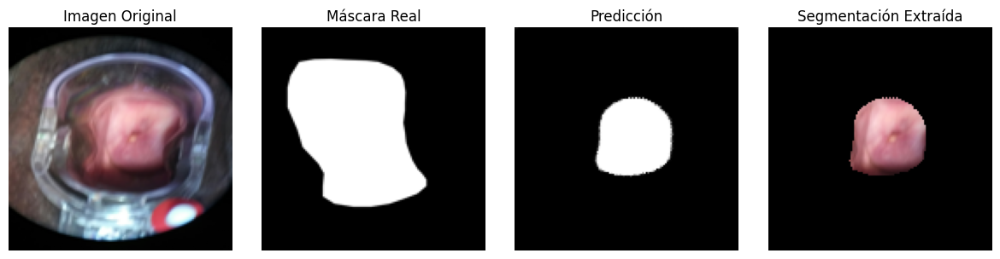

Epoch 127/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62124634, shape=(), dtype=float32)
IoU: 0.621246337890625
DICE: 0.7663812041282654
Epoch 128/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6372878, shape=(), dtype=float32)
IoU: 0.6372877955436707
DICE: 0.7784676551818848
Epoch 129/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.62739444, shape=(), dtype=float32)
IoU: 0.627394437789917
DICE: 0.7710416316986084

🔍 Visualización de muestras - Época 129
1/1 [==============================] - 0s 20ms/step


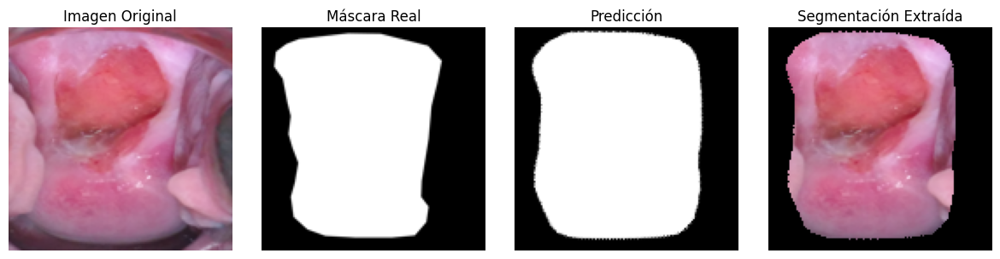

1/1 [==============================] - 0s 18ms/step


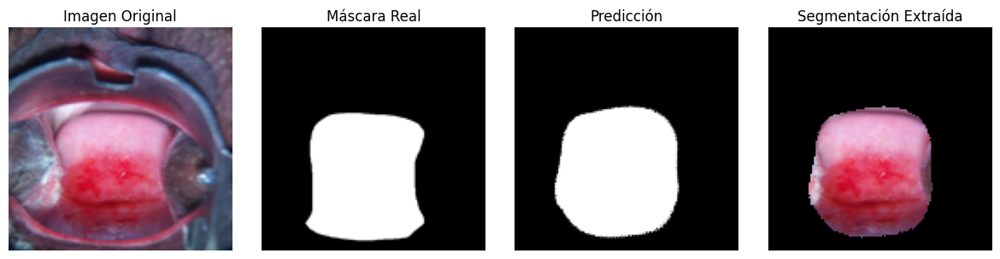

Epoch 130/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6320333, shape=(), dtype=float32)
IoU: 0.6320332884788513
DICE: 0.7745348215103149
Epoch 131/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6323481, shape=(), dtype=float32)
IoU: 0.6323481202125549
DICE: 0.7747711539268494
Epoch 132/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63675207, shape=(), dtype=float32)
IoU: 0.6367520689964294
DICE: 0.7780678272247314

🔍 Visualización de muestras - Época 132
1/1 [==============================] - 0s 19ms/step


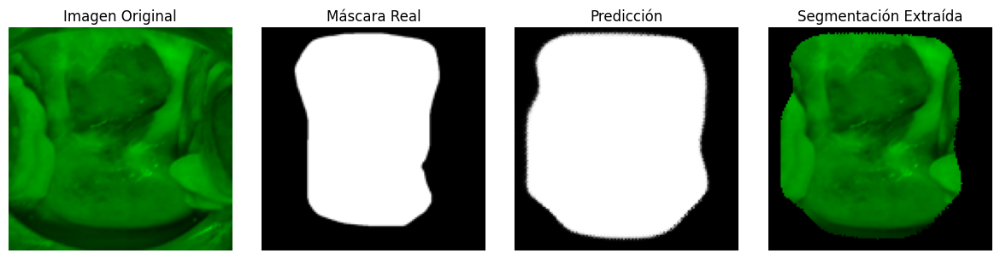

1/1 [==============================] - 0s 19ms/step


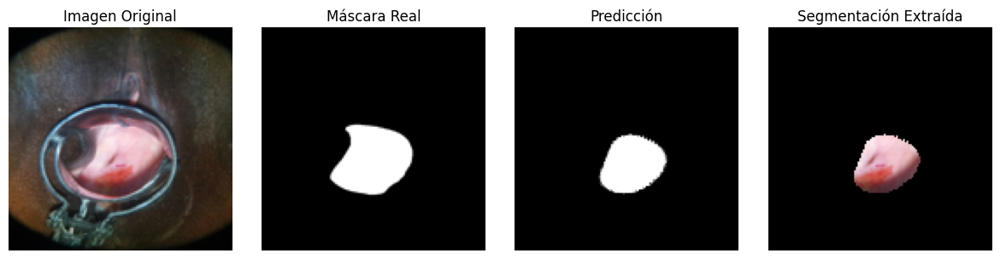

Epoch 133/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63625157, shape=(), dtype=float32)
IoU: 0.6362515687942505
DICE: 0.7776941061019897
Epoch 134/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6363807, shape=(), dtype=float32)
IoU: 0.636380672454834
DICE: 0.7777905464172363
Epoch 135/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63733053, shape=(), dtype=float32)
IoU: 0.6373305320739746
DICE: 0.7784995436668396

🔍 Visualización de muestras - Época 135
1/1 [==============================] - 0s 18ms/step


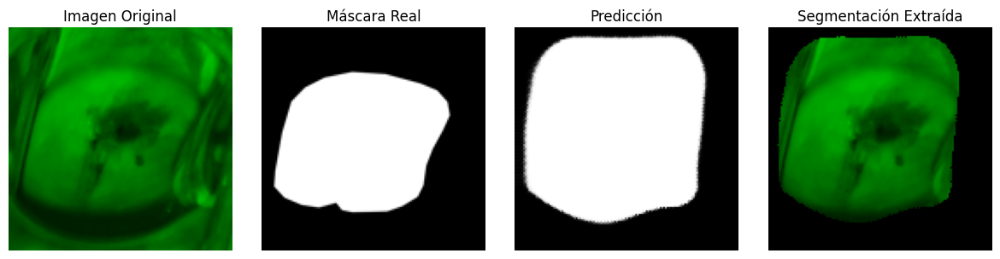

1/1 [==============================] - 0s 19ms/step


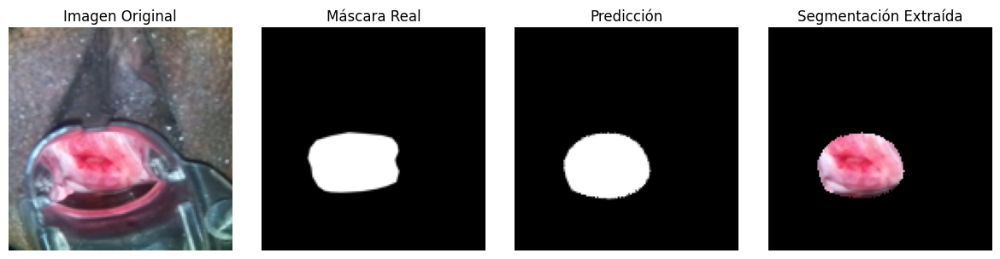

Epoch 136/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6282165, shape=(), dtype=float32)
IoU: 0.6282165050506592
DICE: 0.7716621160507202
Epoch 137/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63301855, shape=(), dtype=float32)
IoU: 0.6330185532569885
DICE: 0.7752742171287537
Epoch 138/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6351144, shape=(), dtype=float32)
IoU: 0.6351143717765808
DICE: 0.7768439650535583

🔍 Visualización de muestras - Época 138
1/1 [==============================] - 0s 19ms/step


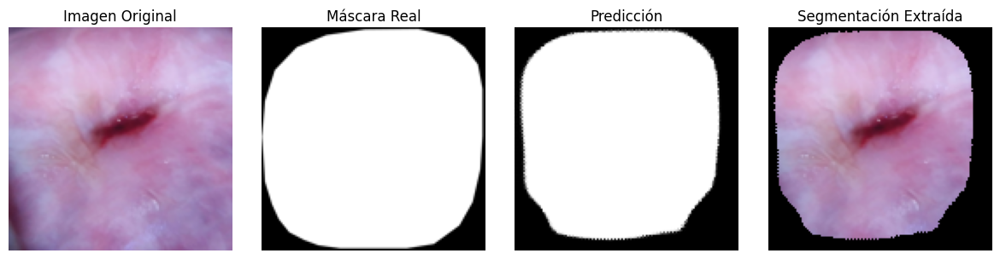

1/1 [==============================] - 0s 19ms/step


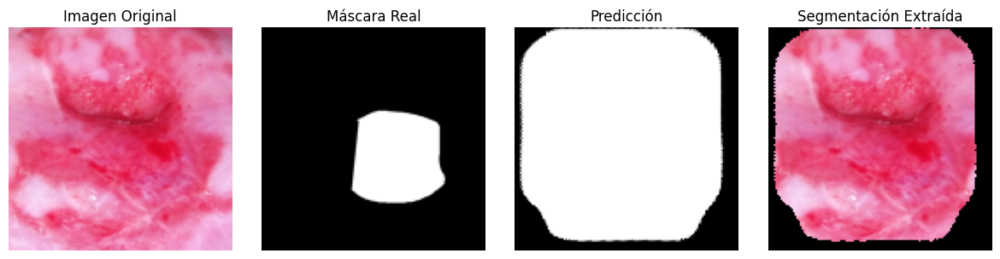

Epoch 139/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63799196, shape=(), dtype=float32)
IoU: 0.6379919648170471
DICE: 0.778992772102356
Epoch 140/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6376613, shape=(), dtype=float32)
IoU: 0.6376612782478333
DICE: 0.7787462472915649
Epoch 141/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6411239, shape=(), dtype=float32)
IoU: 0.64112389087677
DICE: 0.7813229560852051

🔍 Visualización de muestras - Época 141
1/1 [==============================] - 0s 18ms/step


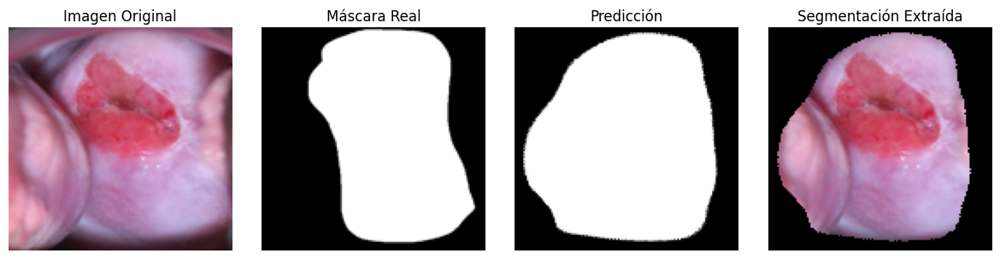

1/1 [==============================] - 0s 19ms/step


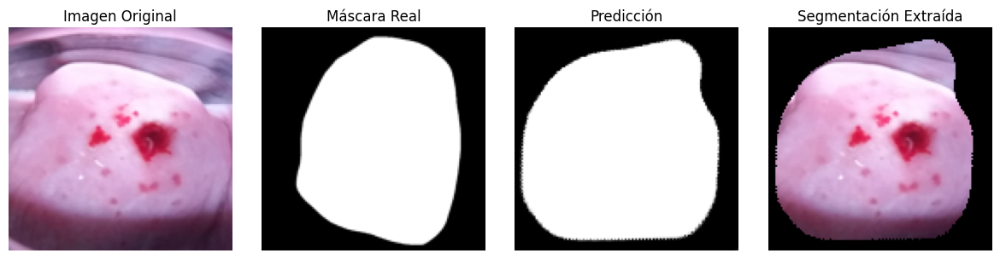

Epoch 142/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6351449, shape=(), dtype=float32)
IoU: 0.6351448893547058
DICE: 0.7768667936325073
Epoch 143/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.61811, shape=(), dtype=float32)
IoU: 0.6181100010871887
DICE: 0.7639901041984558
Epoch 144/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6396604, shape=(), dtype=float32)
IoU: 0.6396604180335999
DICE: 0.780235230922699

🔍 Visualización de muestras - Época 144
1/1 [==============================] - 0s 19ms/step


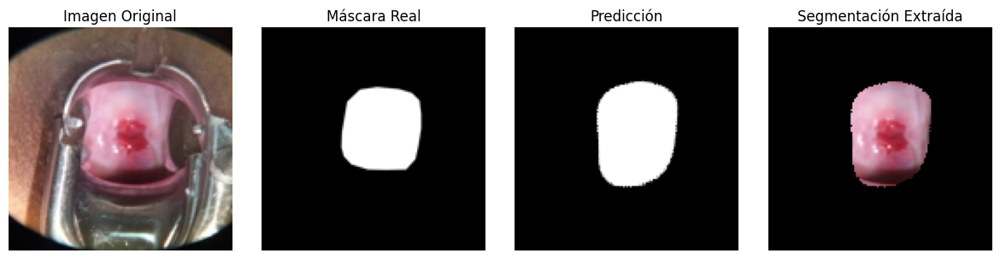

1/1 [==============================] - 0s 18ms/step


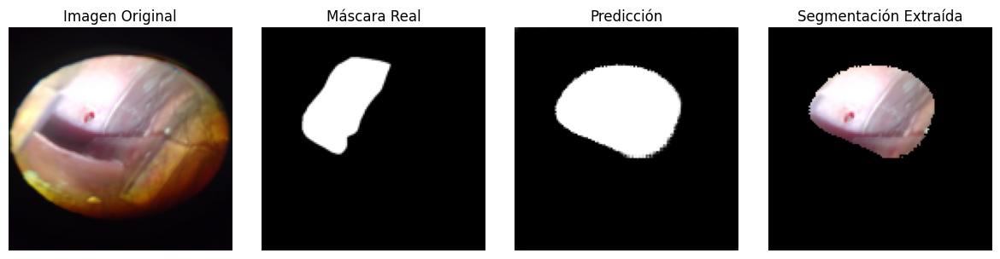

Epoch 145/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.64232683, shape=(), dtype=float32)
IoU: 0.642326831817627
DICE: 0.7822155952453613
Epoch 146/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6392167, shape=(), dtype=float32)
IoU: 0.6392167210578918
DICE: 0.7799050807952881
Epoch 147/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.631155, shape=(), dtype=float32)
IoU: 0.6311550140380859
DICE: 0.7738749980926514

🔍 Visualización de muestras - Época 147
1/1 [==============================] - 0s 18ms/step


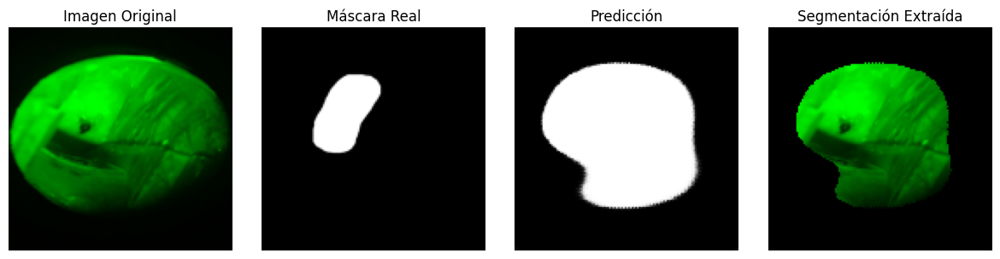

1/1 [==============================] - 0s 20ms/step


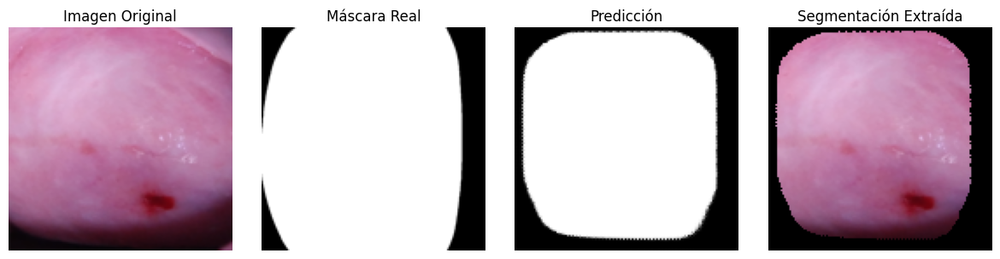

Epoch 148/150
2/2 [==============================] - 0s 6ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.64030343, shape=(), dtype=float32)
IoU: 0.6403034329414368
DICE: 0.7807134389877319
Epoch 149/150
2/2 [==============================] - 0s 7ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.6381018, shape=(), dtype=float32)
IoU: 0.6381018161773682
DICE: 0.7790746688842773
Epoch 150/150
2/2 [==============================] - 0s 5ms/step
y_true shape: (47, 128, 128)
y_pred shape: (47, 128, 128)
Iou: tf.Tensor(0.63214, shape=(), dtype=float32)
IoU: 0.6321399807929993
DICE: 0.7746148705482483

🔍 Visualización de muestras - Época 150
1/1 [==============================] - 0s 21ms/step


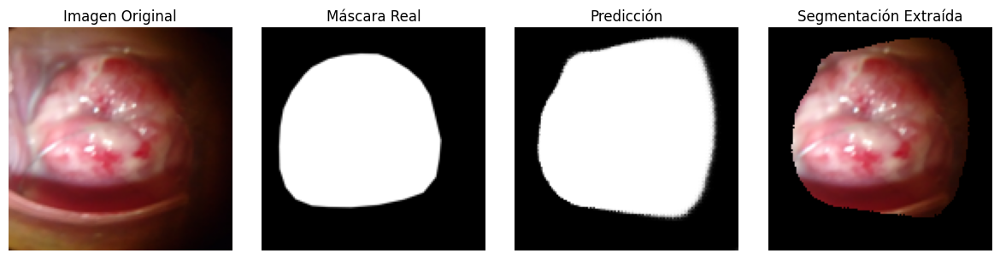

1/1 [==============================] - 0s 19ms/step


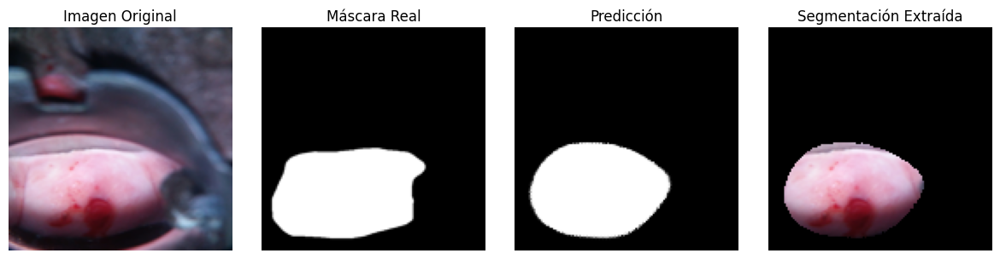

In [18]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, verbose=1, min_lr=1e-6)

for epoch in range(epochs):
    print(f"Epoch {epoch+1}/{epochs}")
    
    # Entrenamiento
    history = model.fit(
        train_images, train_masks,
        epochs=1,
        batch_size=batch_size,
        validation_data=(val_images, val_masks),
        callbacks=[checkpoint_callback, early_stop, lr_reduce]
    )

    # Métricas personalizadas
    val_predictions = model.predict(val_images)
    iou = iou_metric(val_masks, val_predictions)
    print("Iou:",iou )
    dice = dice_metric(val_masks, val_predictions)
    # Guardar métricas
    loss_history.append(history.history["loss"][0])
    val_loss_history.append(history.history["val_loss"][0])
    iou_history.append(iou.numpy())
    dice_history.append(dice.numpy())

    
    print(f"IoU: {iou.numpy()}")
    print(f"DICE: {dice.numpy()}")
    
    # Visualización
    visualizador.on_epoch_end(epoch)

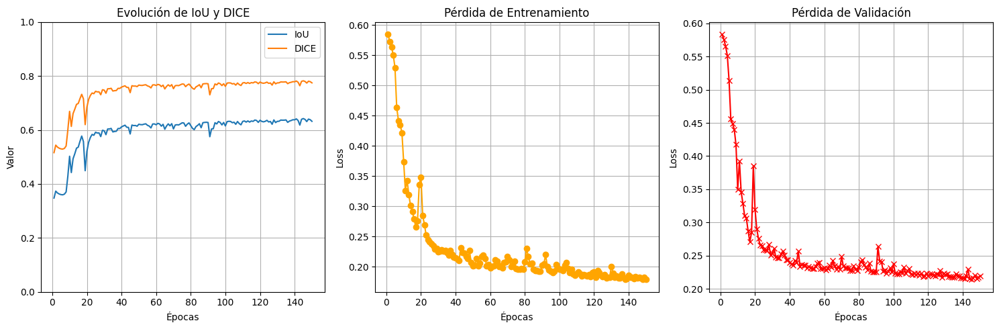

In [19]:
import matplotlib.pyplot as plt

epocas = list(range(1, epochs + 1))

plt.figure(figsize=(15, 5))

# 🔹 IoU y DICE
plt.subplot(1, 3, 1)
plt.plot(epocas, iou_history, label="IoU")
plt.plot(epocas, dice_history, label="DICE")
plt.title("Evolución de IoU y DICE")
plt.xlabel("Épocas")
plt.ylabel("Valor")
plt.ylim(0, 1)
plt.grid(True)
plt.legend()

# 🔹 Pérdida de entrenamiento
plt.subplot(1, 3, 2)
plt.plot(epocas, loss_history, label="Loss", color="orange", marker='o')
plt.title("Pérdida de Entrenamiento")
plt.xlabel("Épocas")
plt.ylabel("Loss")
plt.grid(True)

# 🔹 Pérdida de validación
plt.subplot(1, 3, 3)
plt.plot(epocas, val_loss_history, label="Val Loss", color="red", marker='x')
plt.title("Pérdida de Validación")
plt.xlabel("Épocas")
plt.ylabel("Loss")
plt.grid(True)

plt.tight_layout()
plt.show()


## 5. Pruebas con el Conjunto de Prueba

Una vez entrenado el modelo, podemos cargar el mejor modelo guardado y realizar las predicciones en el conjunto de prueba.

In [20]:
import matplotlib.pyplot as plt
import cv2

def visualizar_prediccion(img, true_mask, pred_mask, iou, dice, index):
    pred_bin = (pred_mask > 0.5).astype(np.uint8) * 255
    if pred_bin.shape != img.shape[:2]:
        pred_bin = cv2.resize(pred_bin, (img.shape[1], img.shape[0]))

    segmentada = cv2.bitwise_and((img * 255).astype(np.uint8),
                                 (img * 255).astype(np.uint8),
                                 mask=pred_bin)

    plt.figure(figsize=(14, 3))
    
    plt.subplot(1, 4, 1)
    plt.imshow(img)
    plt.title("Imagen Original")
    plt.axis("off")

    plt.subplot(1, 4, 2)
    plt.imshow(true_mask, cmap='gray')
    plt.title("Máscara Real")
    plt.axis("off")

    plt.subplot(1, 4, 3)
    plt.imshow(pred_mask.squeeze(), cmap='gray')
    plt.title("Predicción")
    plt.axis("off")

    plt.subplot(1, 4, 4)
    plt.imshow(segmentada)
    plt.title(f"Segmentación (IoU: {iou:.2f}, DICE: {dice:.2f})")
    plt.axis("off")

    plt.suptitle(f"Muestra {index+1}", fontsize=12)
    plt.tight_layout()
    plt.show()


1/1 [==============================] - 0s 139ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 1/47 | IoU: 0.5962 | DICE: 0.7470


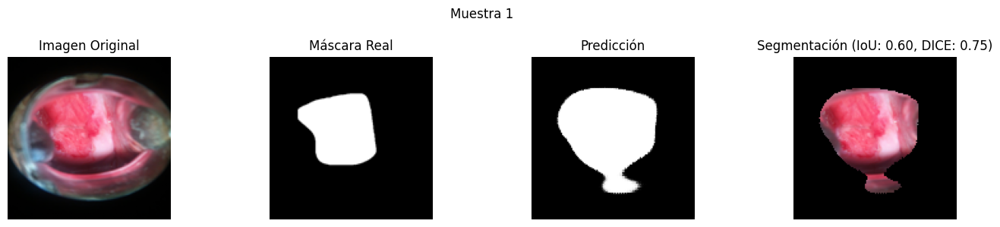

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 2/47 | IoU: 0.6990 | DICE: 0.8229


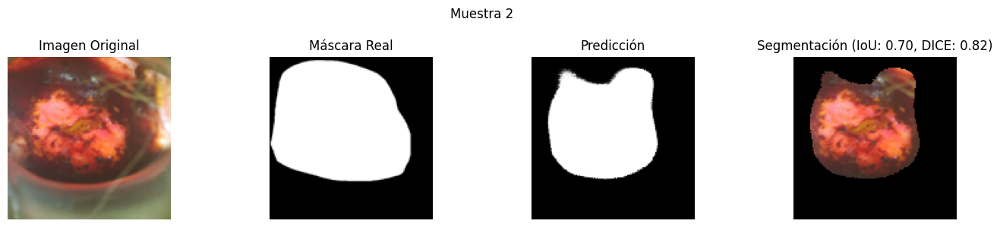

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 3/47 | IoU: 0.8364 | DICE: 0.9109


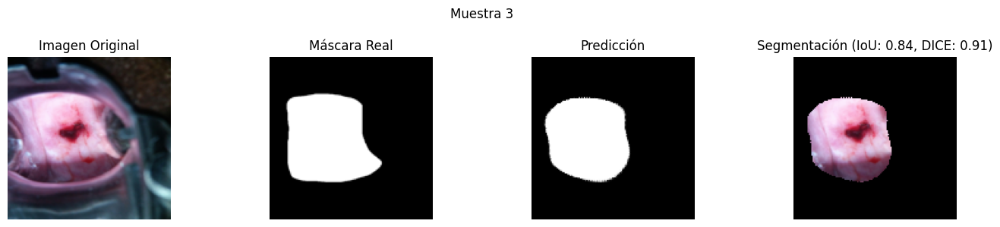

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 4/47 | IoU: 0.7972 | DICE: 0.8871


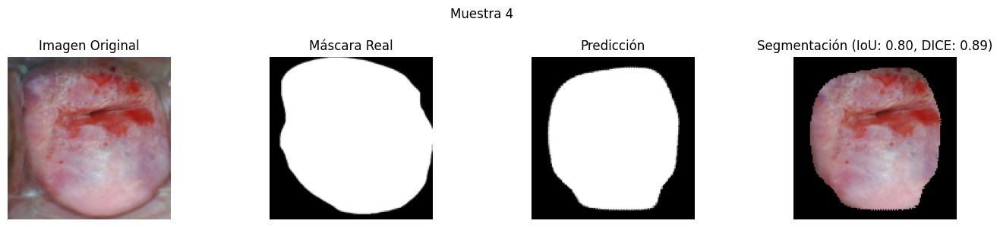

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 5/47 | IoU: 0.6460 | DICE: 0.7849


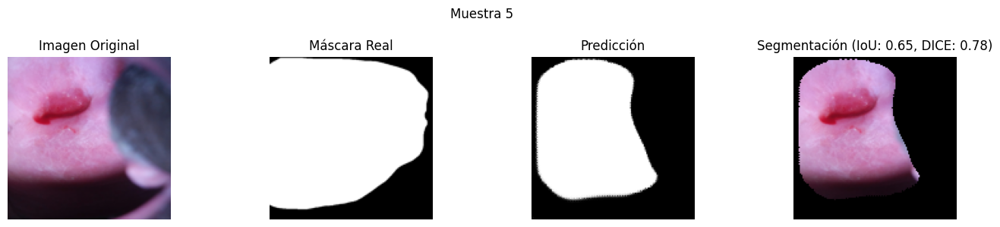

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 6/47 | IoU: 0.8354 | DICE: 0.9103


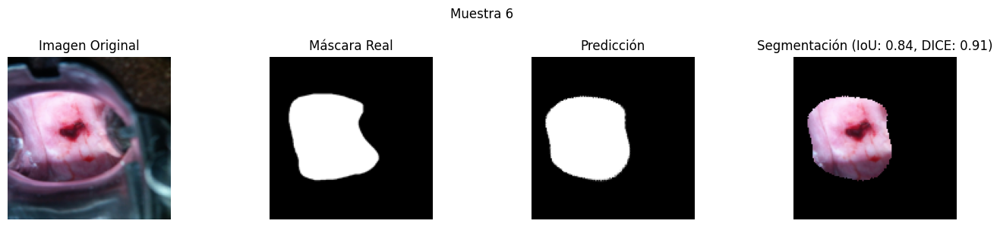

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 7/47 | IoU: 0.5362 | DICE: 0.6981


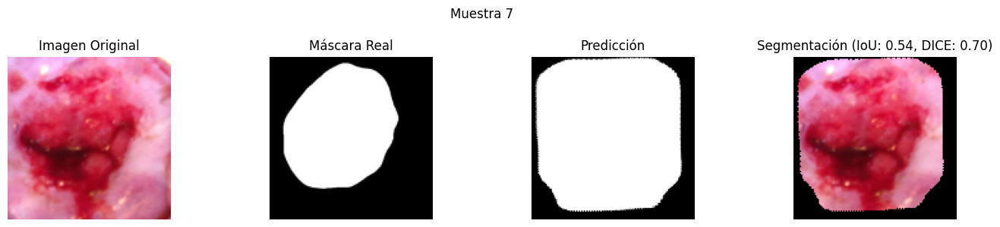

1/1 [==============================] - 0s 20ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 8/47 | IoU: 0.2643 | DICE: 0.4181


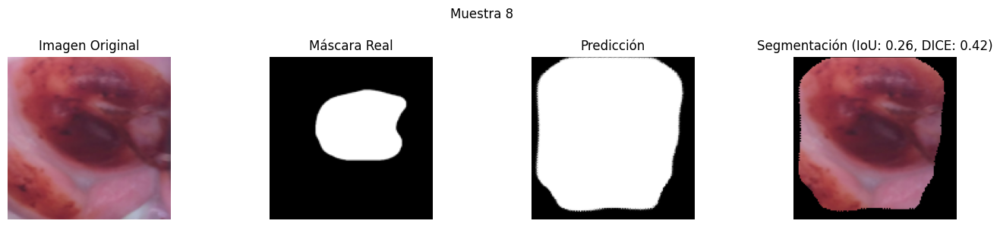

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 9/47 | IoU: 0.7742 | DICE: 0.8727


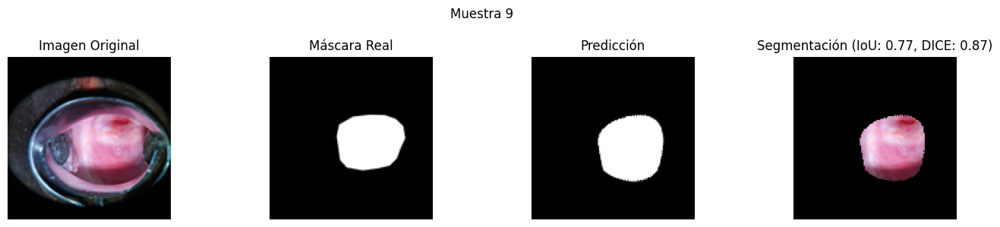

1/1 [==============================] - 0s 20ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 10/47 | IoU: 0.3486 | DICE: 0.5170


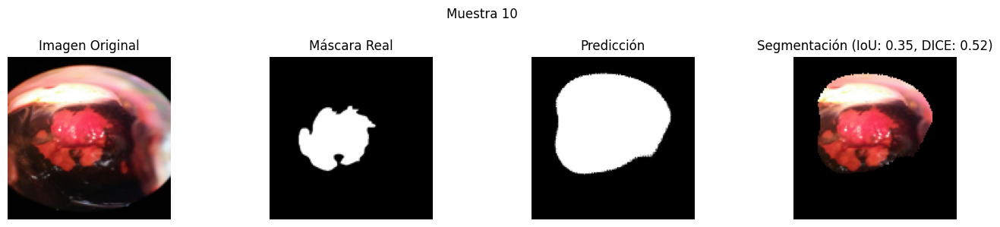

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 11/47 | IoU: 0.7690 | DICE: 0.8694


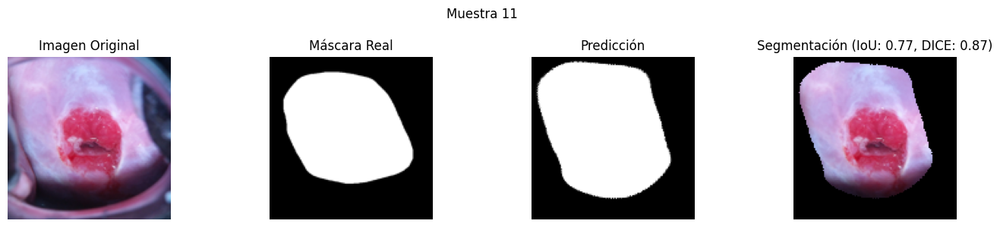

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 12/47 | IoU: 0.4760 | DICE: 0.6450


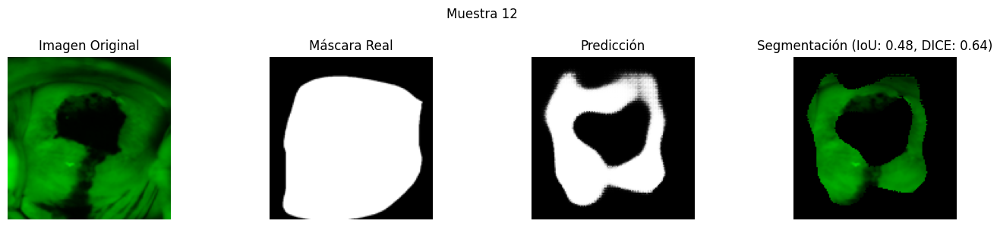

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 13/47 | IoU: 0.8789 | DICE: 0.9356


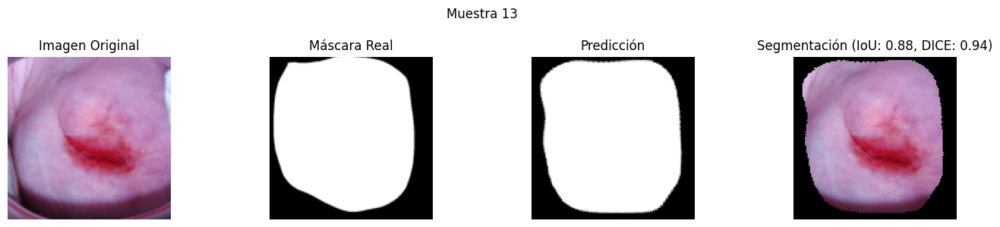

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 14/47 | IoU: 0.8152 | DICE: 0.8982


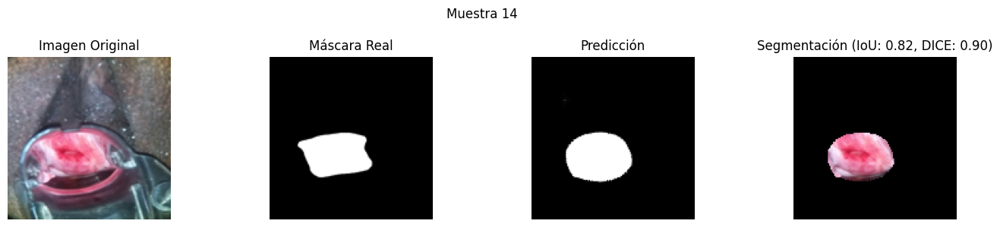

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 15/47 | IoU: 0.5690 | DICE: 0.7253


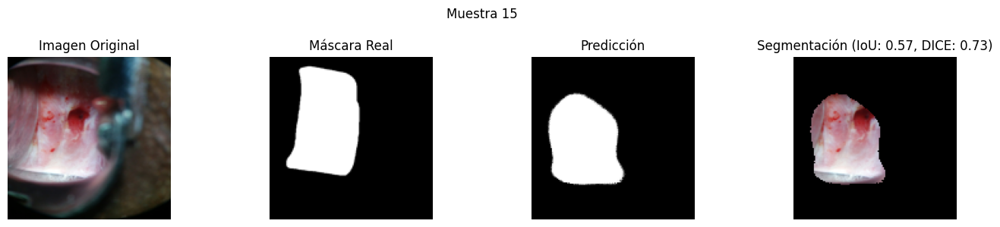

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 16/47 | IoU: 0.4788 | DICE: 0.6476


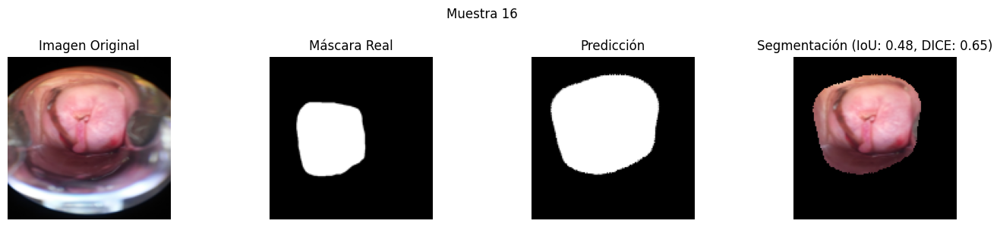

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 17/47 | IoU: 0.4422 | DICE: 0.6133


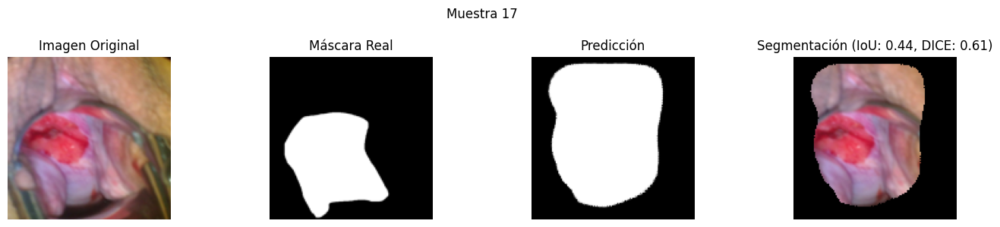

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 18/47 | IoU: 0.8071 | DICE: 0.8933


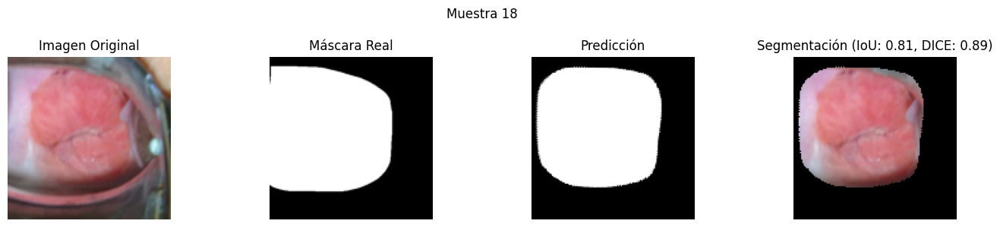

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 19/47 | IoU: 0.3528 | DICE: 0.5216


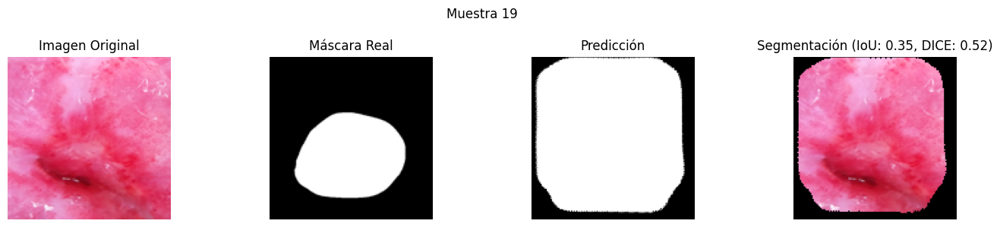

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 20/47 | IoU: 0.7322 | DICE: 0.8454


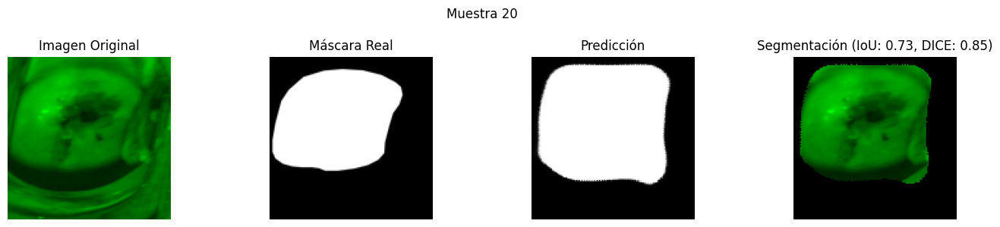

1/1 [==============================] - 0s 20ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 21/47 | IoU: 0.5439 | DICE: 0.7046


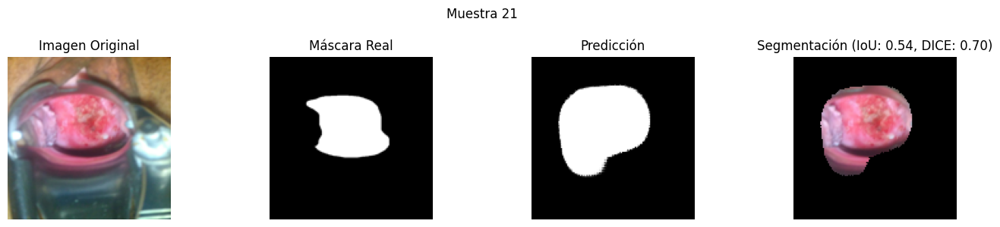

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 22/47 | IoU: 0.7723 | DICE: 0.8715


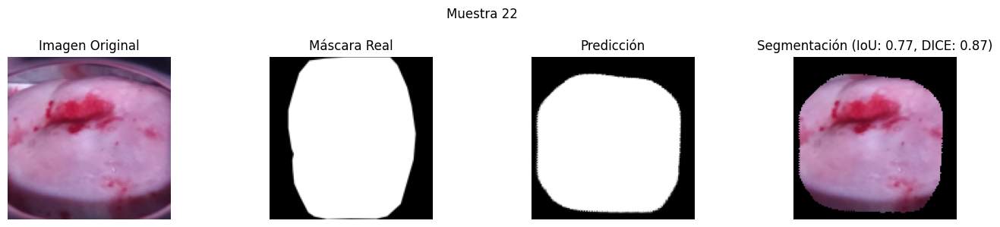

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 23/47 | IoU: 0.7359 | DICE: 0.8479


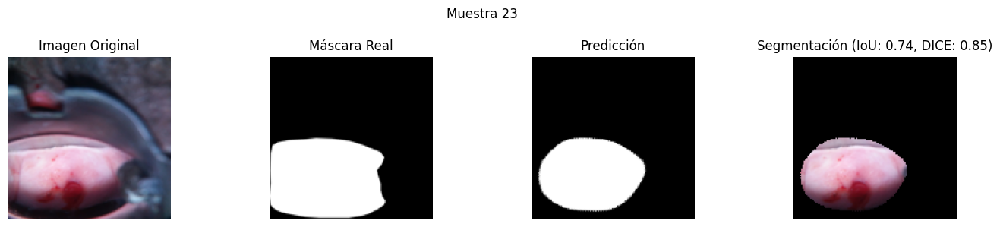

1/1 [==============================] - 0s 21ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 24/47 | IoU: 0.7417 | DICE: 0.8517


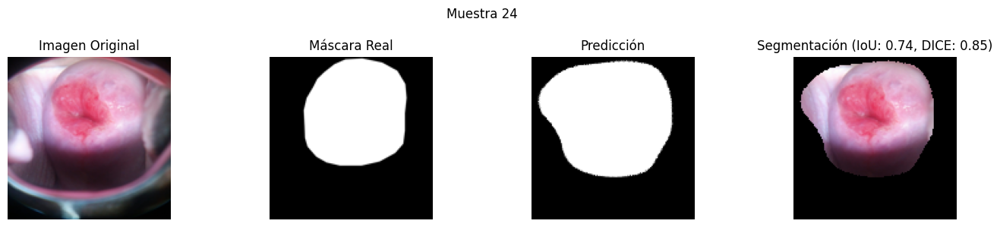

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 25/47 | IoU: 0.5489 | DICE: 0.7087


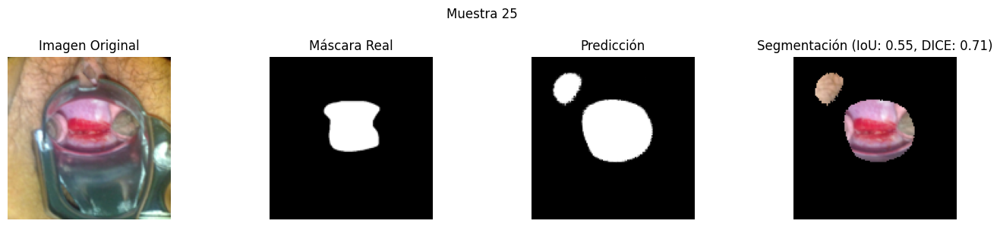

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 26/47 | IoU: 0.7602 | DICE: 0.8638


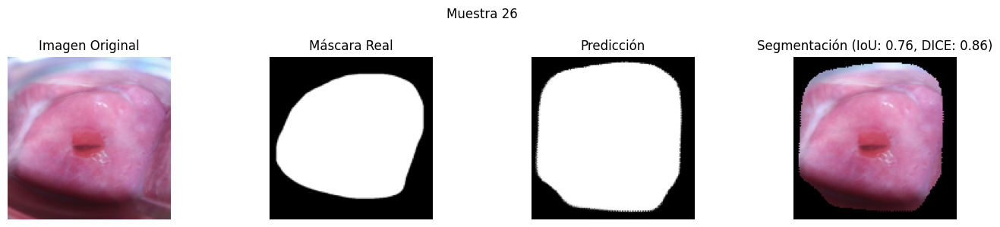

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 27/47 | IoU: 0.3674 | DICE: 0.5374


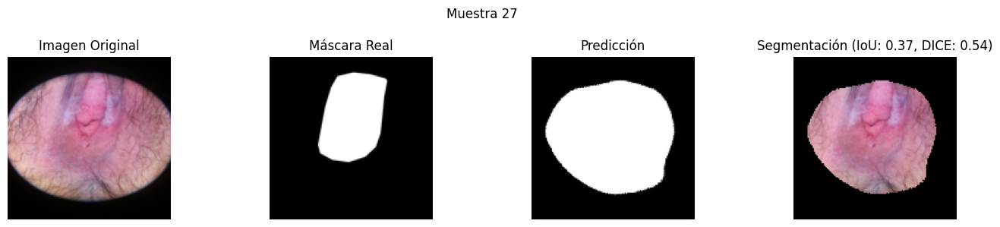

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 28/47 | IoU: 0.6796 | DICE: 0.8092


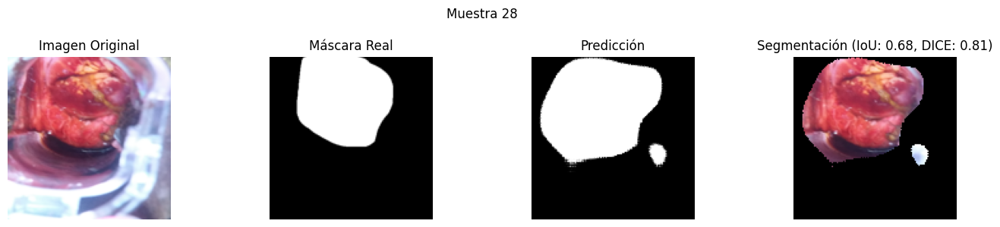

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 29/47 | IoU: 0.8357 | DICE: 0.9105


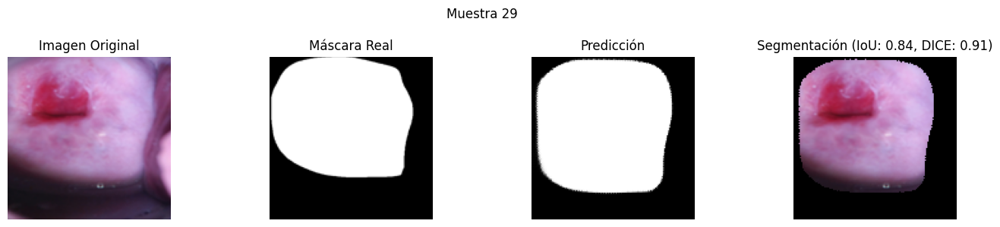

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 30/47 | IoU: 0.8371 | DICE: 0.9113


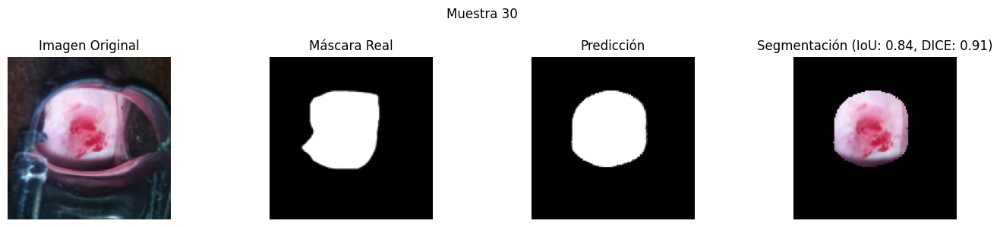

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 31/47 | IoU: 0.6339 | DICE: 0.7759


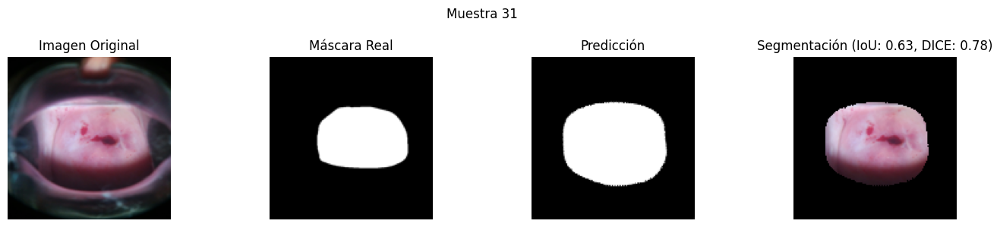

1/1 [==============================] - 0s 20ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 32/47 | IoU: 0.7238 | DICE: 0.8397


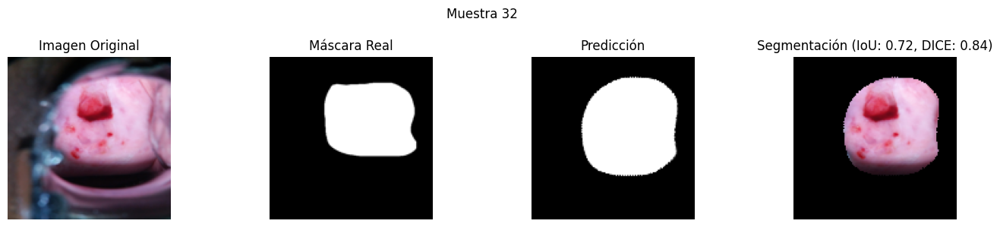

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 33/47 | IoU: 0.7450 | DICE: 0.8539


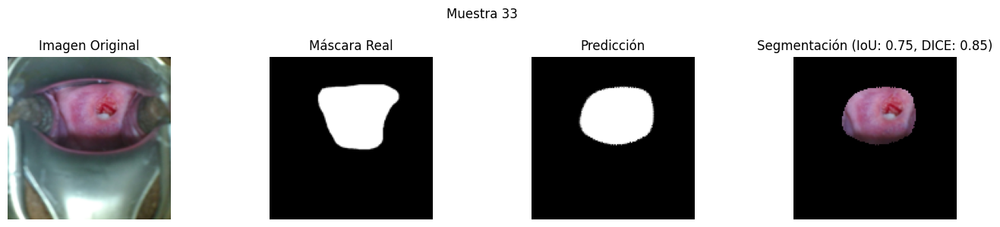

1/1 [==============================] - 0s 20ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 34/47 | IoU: 0.8871 | DICE: 0.9402


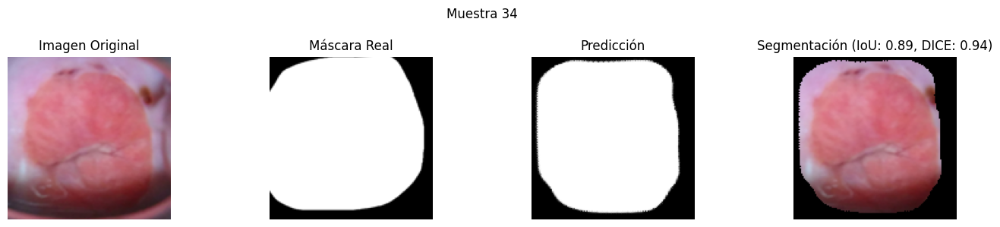

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 35/47 | IoU: 0.7248 | DICE: 0.8404


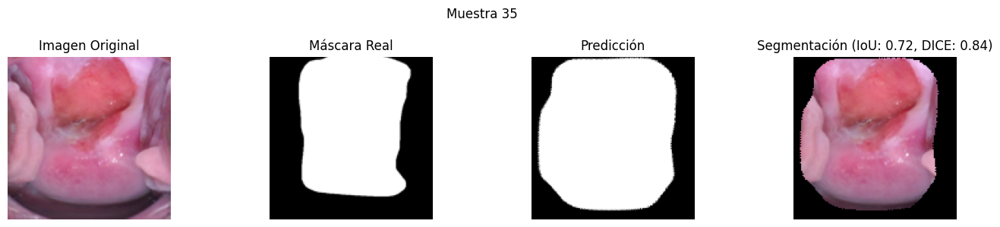

1/1 [==============================] - 0s 21ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 36/47 | IoU: 0.5223 | DICE: 0.6862


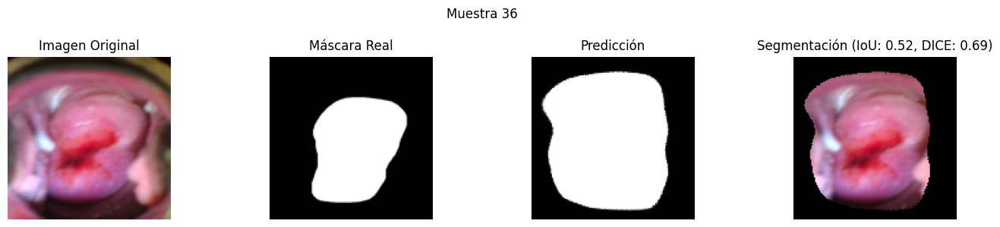

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 37/47 | IoU: 0.4792 | DICE: 0.6479


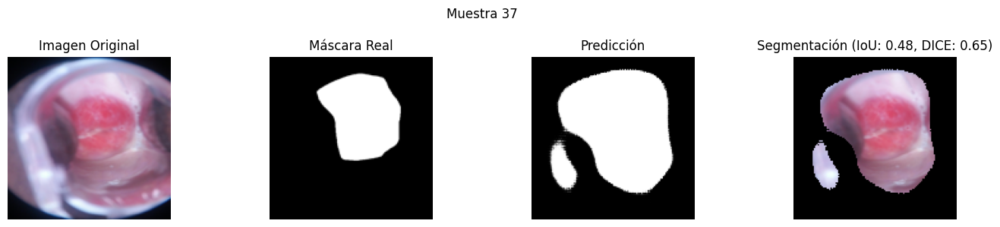

1/1 [==============================] - 0s 20ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 38/47 | IoU: 0.6098 | DICE: 0.7576


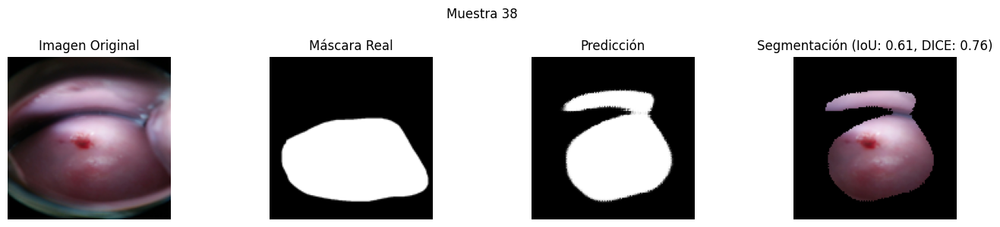

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 39/47 | IoU: 0.7241 | DICE: 0.8400


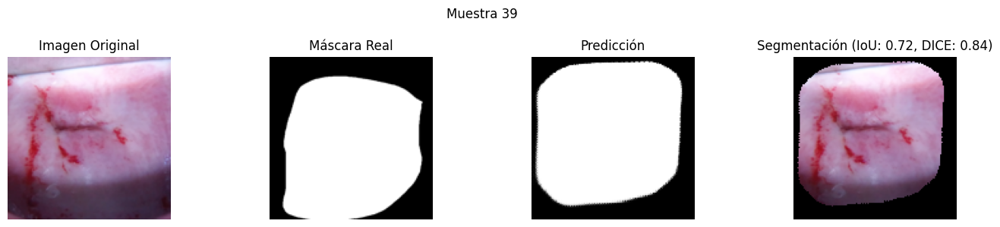

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 40/47 | IoU: 0.5424 | DICE: 0.7033


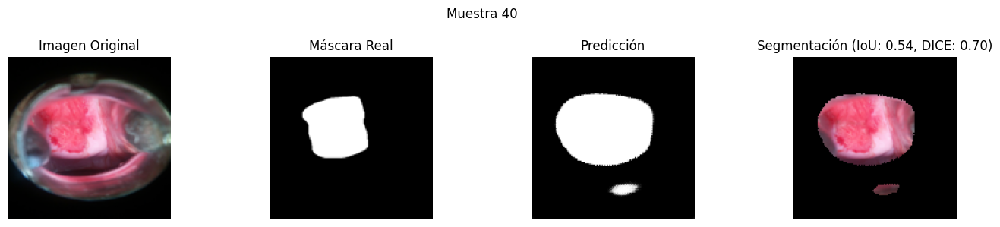

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 41/47 | IoU: 0.6205 | DICE: 0.7658


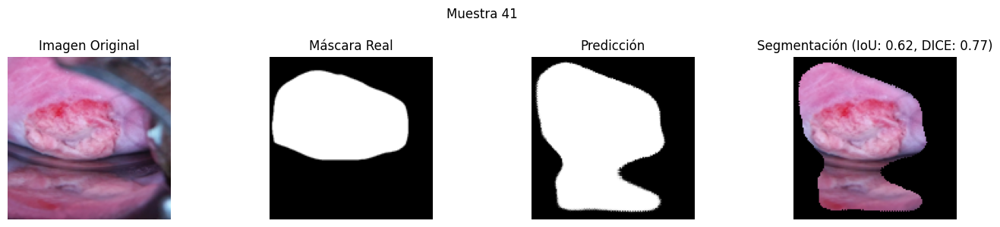

1/1 [==============================] - 0s 20ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 42/47 | IoU: 0.8138 | DICE: 0.8973


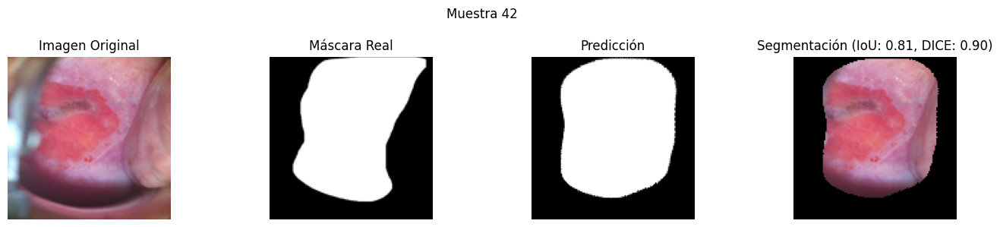

1/1 [==============================] - 0s 18ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 43/47 | IoU: 0.8469 | DICE: 0.9171


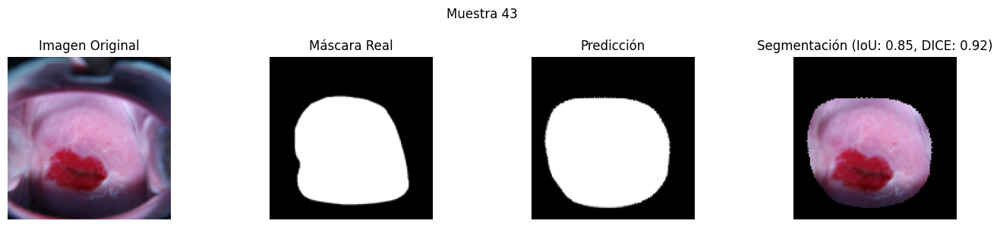

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 44/47 | IoU: 0.6790 | DICE: 0.8088


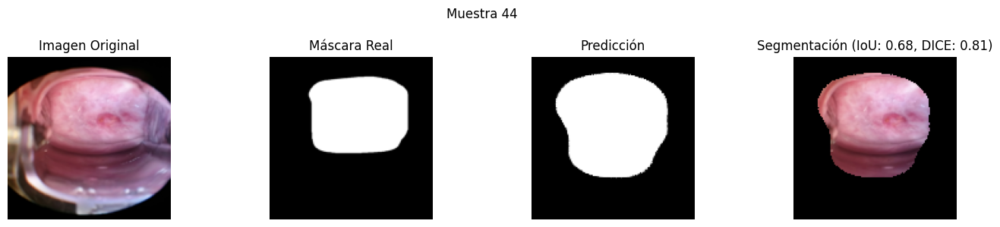

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 45/47 | IoU: 0.5416 | DICE: 0.7027


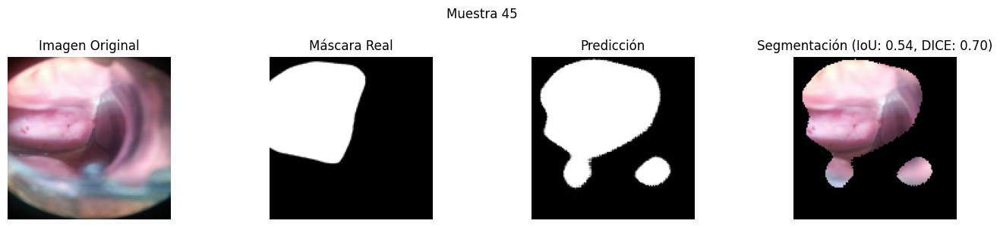

1/1 [==============================] - 0s 20ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 46/47 | IoU: 0.5995 | DICE: 0.7496


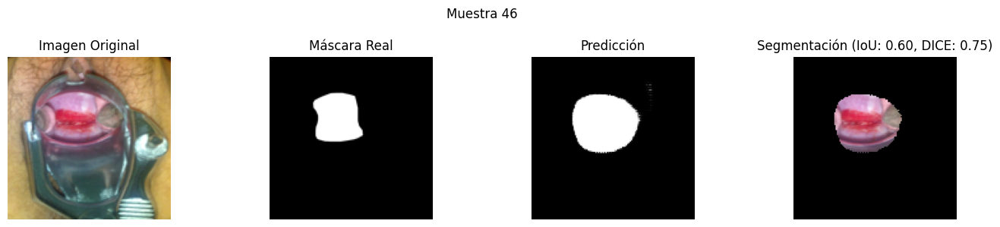

1/1 [==============================] - 0s 19ms/step
y_true shape: (128, 128)
y_pred shape: (128, 128)
📍 Imagen 47/47 | IoU: 0.7147 | DICE: 0.8336


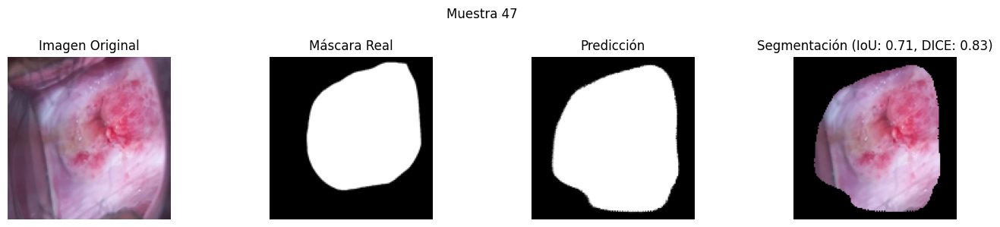


📊 Evaluación global en el conjunto de prueba:
🔹 Promedio IoU: 0.6571
🔹 Promedio DICE: 0.7817


In [21]:
from tensorflow.keras.models import load_model
import numpy as np

# Cargar el modelo
model = load_model('best_model.h5', custom_objects={'dice_loss': dice_loss})

# Datos de prueba
test_images, test_masks = load_data_from_dataframe(test_df, ROIS_DIR, ROIS_DIR, target_size=(128, 128))

# Métricas
ious = []
dices = []

# Evaluar una por una
for i in range(len(test_images)):
    img = np.expand_dims(test_images[i], axis=0)
    true_mask = test_masks[i]
    
    pred_mask = model.predict(img)[0]

    # Calcular métricas
    iou = iou_metric(true_mask, pred_mask).numpy()
    dice = dice_metric(true_mask, pred_mask).numpy()

    ious.append(iou)
    dices.append(dice)

    print(f"📍 Imagen {i+1}/{len(test_images)} | IoU: {iou:.4f} | DICE: {dice:.4f}")

    # Visualizar predicción
    visualizar_prediccion(test_images[i], true_mask, pred_mask, iou, dice, i)

# Promedios
mean_iou = np.mean(ious)
mean_dice = np.mean(dices)

print("\n📊 Evaluación global en el conjunto de prueba:")
print(f"🔹 Promedio IoU: {mean_iou:.4f}")
print(f"🔹 Promedio DICE: {mean_dice:.4f}")


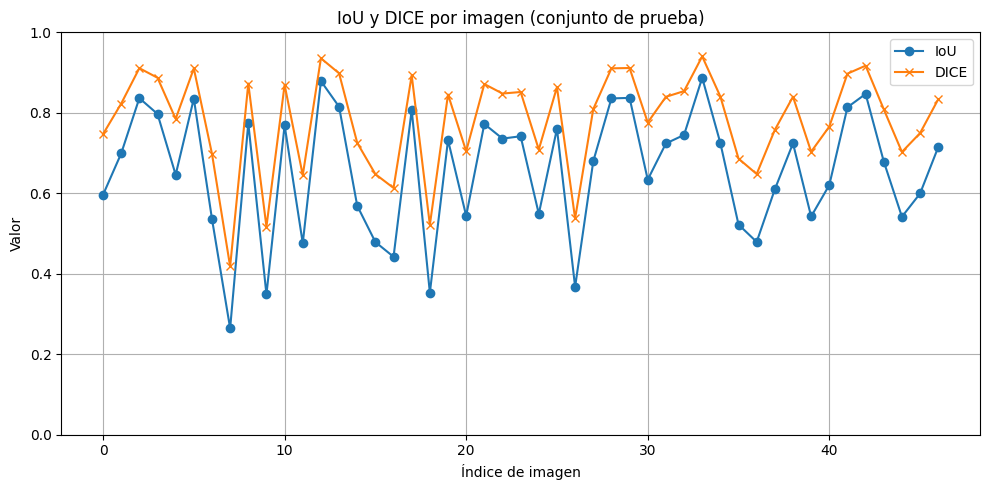

In [22]:
plt.figure(figsize=(10, 5))
plt.plot(ious, label="IoU", marker='o')
plt.plot(dices, label="DICE", marker='x')
plt.title("IoU y DICE por imagen (conjunto de prueba)")
plt.xlabel("Índice de imagen")
plt.ylabel("Valor")
plt.ylim(0, 1)
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


In [23]:
print("\n" + "="*50)
print("🏁 RESULTADOS FINALES DE SEGMENTACIÓN ROI")
print("="*50)
print(f"📐 Promedio IoU sobre el conjunto de prueba:  {mean_iou:.4f}")
print(f"💠 Promedio DICE sobre el conjunto de prueba: {mean_dice:.4f}")
print("="*50)



🏁 RESULTADOS FINALES DE SEGMENTACIÓN ROI
📐 Promedio IoU sobre el conjunto de prueba:  0.6571
💠 Promedio DICE sobre el conjunto de prueba: 0.7817


# 🔬 Clasificación de Lesiones Cervicales con Detectron2

## 📄 Descripción

Este cuaderno tiene como objetivo desarrollar un modelo de aprendizaje profundo utilizando la arquitectura Mask R-CNN con Detectron2, orientado a la **clasificación y detección de lesiones cervicales** en imágenes biomédicas. Para ello, se parte de anotaciones previamente generadas en formato **COCO JSON** o **VGG VIA**. Se implementan procesos de unificación, conversión, registro de datasets, visualización, entrenamiento del modelo y análisis de resultados.

Detectron2 ofrece una solución robusta y altamente optimizada para tareas de detección y segmentación de instancias, y su uso en este contexto busca automatizar y mejorar la precisión del diagnóstico colposcópico.

---

## 🎯 Objetivos

- Unificar anotaciones de diferentes fuentes (COCO, VGG VIA) en un único archivo estándar.
- Registrar datasets personalizados en Detectron2 para su uso en entrenamiento y validación.
- Entrenar un modelo Mask R-CNN desde `model_zoo` para clasificación y segmentación de lesiones.
- Evaluar el rendimiento del modelo en términos de precisión y detección por clase.
- Exportar segmentaciones, predicciones y métricas en formatos visuales y numéricos.

---


## 📁 Dataset

- **Formato original**: COCO JSON, VGG VIA JSON.
- **Etiquetas esperadas**: `demy`, `isch`, entre otras posibles relacionadas a tipos de lesión.
- **Origen**: Imágenes biomédicas de cervix provenientes de estudios clínicos (Intel dataset, KAIME, etc.).

---

## 💻 Herramientas

- Google Colab / Jupyter Notebook
- Detectron2 (Facebook AI Research)
- OpenCV, Matplotlib, Pandas
- PyTorch (con soporte CUDA)
- makesense.ai / VGG VIA (para anotaciones)
---

/tf/workspace/ColpoToolLab/intel
🖼️ Total imágenes .jpg en Intel: 230
🔍 Ejemplos: ['1283.jpg', '1488.jpg', '460.jpg', '2654.jpg', '2682.jpg']

📦 Procesando: colpo_2_coco.json
📷 Imágenes en JSON: 74 | 🧩 Anotaciones: 343

📦 Procesando: coco_labels_32_aw_m_p_av_2025-04-10-07-28-25.json
📷 Imágenes en JSON: 31 | 🧩 Anotaciones: 88

✅ Total imágenes válidas: 74
✅ Total anotaciones válidas: 431

📊 Conteo por clase:
 - Clase 1: 156
 - Clase 3: 162
 - Clase 2: 45
 - Clase 4: 61
 - Clase 5: 7

🧪 Muestra de 5 anotaciones:
 - Imagen: 10.jpg, Clase: 1, Segmento: [[1435.6120826709057, 2469.2527821939575...
 - Imagen: 10.jpg, Clase: 1, Segmento: [[2182.1303656597765, 1534.0540540540535...
 - Imagen: 10.jpg, Clase: 1, Segmento: [[2485.6597774244824, 1788.3624801271853...
 - Imagen: 10.jpg, Clase: 3, Segmento: [[914.6899841017485, 1402.7980922098563,...
 - Imagen: 10.jpg, Clase: 3, Segmento: [[713.7042925278216, 1890.9062003179642,...


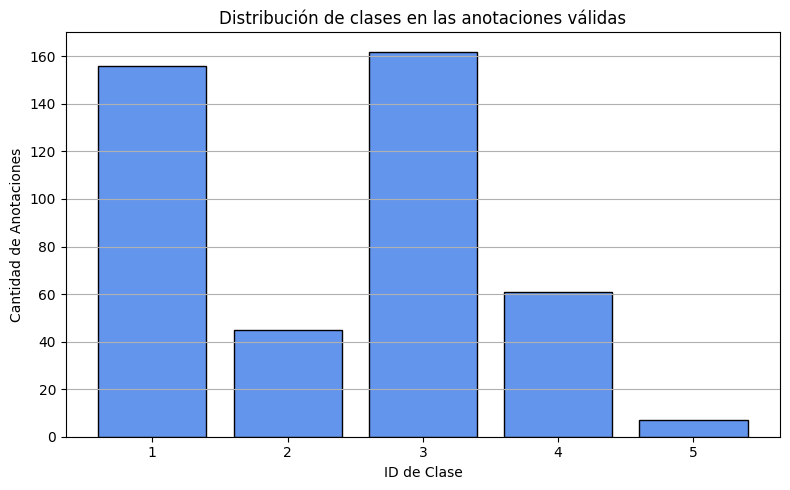

In [24]:
import json
from pathlib import Path
from collections import Counter

# 📁 Rutas reales (ajusta si estás en otro directorio)
BASE_DIR = Path.cwd()
INTEL_DIR = BASE_DIR / "intel"
print(INTEL_DIR )
JSON_DIR = BASE_DIR / "detectron_data"

# 🧾 Archivos JSON que sí quieres usar
json_paths = [
    JSON_DIR / "colpo_2_coco.json",
    JSON_DIR / "coco_labels_32_aw_m_p_av_2025-04-10-07-28-25.json"
]

# 📂 Paso 1: Listar imágenes reales en carpeta Intel
imagenes_intel = {img.name for img in INTEL_DIR.glob("*.jpg")}
print(f"🖼️ Total imágenes .jpg en Intel: {len(imagenes_intel)}")
print(f"🔍 Ejemplos: {list(imagenes_intel)[:5]}")

# 🔄 Paso 2: Cargar JSONs y filtrar imágenes válidas
imagenes_validas = {}
anotaciones_validas = []

for json_file in json_paths:
    print(f"\n📦 Procesando: {json_file.name}")
    if not json_file.exists():
        print(f"❌ Archivo no encontrado: {json_file}")
        continue

    with open(json_file, 'r') as f:
        data = json.load(f)

    images_json = data.get("images", [])
    annotations_json = data.get("annotations", [])

    print(f"📷 Imágenes en JSON: {len(images_json)} | 🧩 Anotaciones: {len(annotations_json)}")

    # Validar imágenes por nombre
    for img in images_json:
        nombre = Path(img["file_name"]).name
        if nombre in imagenes_intel:
            imagenes_validas[img["id"]] = nombre

    # Validar anotaciones por ID de imagen
    for ann in annotations_json:
        if ann["image_id"] in imagenes_validas:
            anotaciones_validas.append({
                "nombre": imagenes_validas[ann["image_id"]],
                "categoria_id": ann["category_id"],
                "segmentacion": ann["segmentation"]
            })
            

# 📊 Paso 3: Conteo por categoría
conteo = Counter()
for ann in anotaciones_validas:
    conteo[ann["categoria_id"]] += 1

# 🧾 Resultados
print(f"\n✅ Total imágenes válidas: {len(imagenes_validas)}")
print(f"✅ Total anotaciones válidas: {len(anotaciones_validas)}")

print("\n📊 Conteo por clase:")
for clase, cantidad in conteo.items():
    print(f" - Clase {clase}: {cantidad}")

print("\n🧪 Muestra de 5 anotaciones:")
for ann in anotaciones_validas[:5]:
    print(f" - Imagen: {ann['nombre']}, Clase: {ann['categoria_id']}, Segmento: {str(ann['segmentacion'])[:40]}...")


import matplotlib.pyplot as plt

# 📊 Recuento de clases
conteo = Counter(ann["categoria_id"] for ann in anotaciones_validas)

if not conteo:
    print("⚠️ No hay datos para graficar.")
else:
    clases = list(conteo.keys())
    cantidades = list(conteo.values())

    plt.figure(figsize=(8, 5))
    plt.bar(clases, cantidades, color='cornflowerblue', edgecolor='black')
    plt.xlabel("ID de Clase")
    plt.ylabel("Cantidad de Anotaciones")
    plt.title("Distribución de clases en las anotaciones válidas")
    plt.grid(axis='y')
    plt.tight_layout()
    plt.show()


In [25]:
import cv2
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog, DatasetCatalog

# ✅ Inicialización
final_images = []
final_annotations = []
img_id_map = {}
img_id_counter = 1
ann_id_counter = 1

for ann in anotaciones_validas:
    nombre = ann["nombre"]
    segmentacion = ann["segmentacion"]

    # ❌ Omitir anotaciones vacías o inválidas
    if not isinstance(segmentacion, list) or len(segmentacion) == 0 or len(segmentacion[0]) < 6:
        print(f"⚠️ Anotación inválida omitida: {nombre}")
        continue

    # 🖼️ Procesar imagen si no está registrada
    if nombre not in img_id_map:
        img_path = str(INTEL_DIR / nombre)
        imagen = cv2.imread(img_path)
        if imagen is None:
            print(f"⚠️ Imagen no encontrada: {nombre}")
            continue
        height, width = imagen.shape[:2]

        final_images.append({
            "id": img_id_counter,
            "file_name": nombre,
            "height": height,
            "width": width
        })
        img_id_map[nombre] = img_id_counter
        img_id_counter += 1

    # 📦 Calcular bbox y área
    puntos = segmentacion[0]
    x_coords = puntos[0::2]
    y_coords = puntos[1::2]
    if not x_coords or not y_coords:
        print(f"⚠️ Coordenadas vacías, omitido: {nombre}")
        continue
    x_min, x_max = min(x_coords), max(x_coords)
    y_min, y_max = min(y_coords), max(y_coords)
    bbox = [x_min, y_min, x_max - x_min, y_max - y_min]
    area = bbox[2] * bbox[3]

    final_annotations.append({
        "id": ann_id_counter,
        "image_id": img_id_map[nombre],
        "category_id": ann["categoria_id"],
        "segmentation": segmentacion,
        "iscrowd": 0,
        "bbox": bbox,
        "area": area
    })
    ann_id_counter += 1

# ✅ Categorías
final_categories = [
    {"id": 1, "name": "aw"},
    {"id": 2, "name": "m"},
    {"id": 3, "name": "p"},
    {"id": 4, "name": "av"},
    {"id": 5, "name": "y"},
]



# 💾 Guardar JSON final
JSON_FILTRADO = JSON_DIR / "coco_labels_filtrado.json"
with open(JSON_FILTRADO, 'w') as f:
    json.dump({
        "images": final_images,
        "annotations": final_annotations,
        "categories": final_categories
    }, f, indent=2)

# 🔀 División 80/20
random.seed(42)
random.shuffle(final_images)
split_idx = int(len(final_images) * 0.8)
train_imgs = final_images[:split_idx]
val_imgs = final_images[split_idx:]
train_ids = {img["id"] for img in train_imgs}
val_ids = {img["id"] for img in val_imgs}
train_anns = [ann for ann in final_annotations if ann["image_id"] in train_ids]
val_anns = [ann for ann in final_annotations if ann["image_id"] in val_ids]

# 💾 Guardar splits
train_json_path = JSON_DIR / "colpo_train.json"
val_json_path = JSON_DIR / "colpo_val.json"
with open(train_json_path, 'w') as f:
    json.dump({
        "images": train_imgs,
        "annotations": train_anns,
        "categories": final_categories
    }, f, indent=2)
with open(val_json_path, 'w') as f:
    json.dump({
        "images": val_imgs,
        "annotations": val_anns,
        "categories": final_categories
    }, f, indent=2)

# 🔁 Registrar datasets en Detectron2
register_coco_instances("colpo_train", {}, str(train_json_path), str(INTEL_DIR))
register_coco_instances("colpo_val", {}, str(val_json_path), str(INTEL_DIR))
colpo_train_metadata = MetadataCatalog.get("colpo_train")
colpo_val_metadata = MetadataCatalog.get("colpo_val")
colpo_train_dicts = DatasetCatalog.get("colpo_train")
colpo_val_dicts = DatasetCatalog.get("colpo_val")

print("✅ Dataset registrado y listo para usar Detectron2.")
with open(JSON_FILTRADO) as f:
    json_data = json.load(f)
    if json_data["images"]:
        print(f"🔎 Primera imagen registrada: {json_data['images'][0]['file_name']}")
    else:
        print("⚠️ No se registraron imágenes.")


✅ Dataset registrado y listo para usar Detectron2.
🔎 Primera imagen registrada: 10.jpg


In [26]:
# Paso 1: Registrar el nuevo dataset COCO con rutas absolutas
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog, DatasetCatalog
import os

# Rutas
dataset_name = "colpo_dataset_filtrado"
images_dir = str(INTEL_DIR)
json_filtrado_path = str(JSON_FILTRADO)

# Registrar dataset
register_coco_instances(dataset_name, {}, json_filtrado_path, images_dir)

# Obtener metadata y dataset dicts
colpo_metadata = MetadataCatalog.get(dataset_name)
colpo_dicts = DatasetCatalog.get(dataset_name)

print(f"✅ Dataset '{dataset_name}' registrado correctamente.")
print(f"🔢 Total de muestras: {len(colpo_dicts)}")


✅ Dataset 'colpo_dataset_filtrado' registrado correctamente.
🔢 Total de muestras: 104


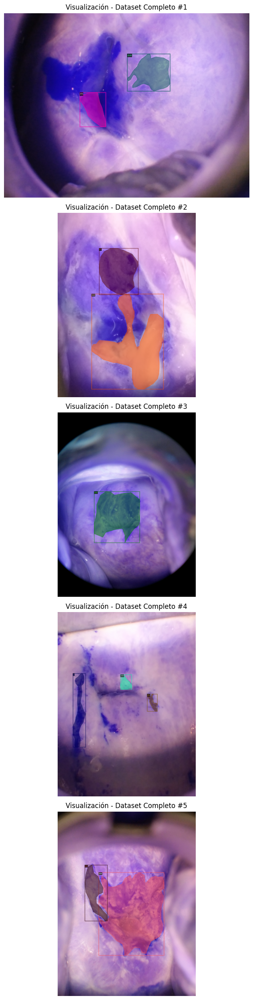

In [27]:
import random
import cv2
import matplotlib.pyplot as plt
from detectron2.utils.visualizer import Visualizer

def visualizar_muestras(dataset_dicts, metadata, num_muestras=5, titulo="Muestras"):
    plt.figure(figsize=(15, 5 * num_muestras))
    count = 0
    for d in random.sample(dataset_dicts, min(num_muestras, len(dataset_dicts))):
        img_path = d["file_name"]
        img = cv2.imread(img_path)

        if img is None:
            print(f"❌ Imagen no encontrada: {img_path}")
            continue

        visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
        vis = visualizer.draw_dataset_dict(d)
        plt.subplot(num_muestras, 1, count + 1)
        plt.imshow(vis.get_image()[:, :, ::-1])
        plt.title(f"{titulo} #{count+1}")
        plt.axis('off')
        count += 1

    if count == 0:
        print("⚠️ No se pudieron visualizar muestras (todas fallaron).")
    else:
        plt.tight_layout()
        plt.show()

# Ejecutar visualización
visualizar_muestras(colpo_dicts, colpo_metadata, num_muestras=5, titulo="Visualización - Dataset Completo")


## ⚙️ Paso: Configuración y entrenamiento del modelo

In [28]:
# ✅ 1. Liberar memoria (opcional pero útil si vienes de sesión previa)
import gc
import torch
gc.collect()
torch.cuda.empty_cache()

# ✅ 2. Seleccionar GPU antes de cualquier import de PyTorch/Detectron2
import os
import subprocess

def get_gpu_with_max_free_memory():
    try:
        result = subprocess.check_output(
            ['nvidia-smi', '--query-gpu=memory.free', '--format=csv,nounits,noheader'],
            encoding='utf-8'
        )
        free_memories = [int(x) for x in result.strip().split('\n')]
        best_gpu = free_memories.index(max(free_memories))
        print(f"🧠 Seleccionando GPU {best_gpu} con {free_memories[best_gpu]} MiB libres.")
        return best_gpu
    except Exception as e:
        print(f"❌ Error al consultar GPU: {e}")
        return 0

# Establecer la GPU visible
best_gpu_id = get_gpu_with_max_free_memory()
os.environ["CUDA_VISIBLE_DEVICES"] = str(best_gpu_id)

# ✅ 3. Importar después de configurar la GPU
import torch
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo

# ✅ 4. Configuración de Detectron2
OUTPUT_DIR = "output/colpo_model"
os.makedirs(OUTPUT_DIR, exist_ok=True)

cfg = get_cfg()
cfg.OUTPUT_DIR = OUTPUT_DIR
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

cfg.DATASETS.TRAIN = ("colpo_train",)
cfg.DATASETS.TEST = ("colpo_val",)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

cfg.TEST.EVAL_PERIOD = 100
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.STEPS = []
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256

# Detectron2 ya entiende que cuda:0 es la GPU visible
cfg.MODEL.DEVICE = "cuda:0"

# ✅ 5. Entrenar
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()



🧠 Seleccionando GPU 1 con 48049 MiB libres.
[04/13 08:17:39 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (6, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (6,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (20, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (20,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (5, 256, 1, 1) 

[04/13 08:17:39 d2.engine.train_loop]: Starting training from iteration 0
ERROR [04/13 08:17:40 d2.engine.train_loop]: Exception during training:
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/detectron2/engine/train_loop.py", line 155, in train
    self.run_step()
  File "/usr/local/lib/python3.11/dist-packages/detectron2/engine/defaults.py", line 530, in run_step
    self._trainer.run_step()
  File "/usr/local/lib/python3.11/dist-packages/detectron2/engine/train_loop.py", line 310, in run_step
    loss_dict = self.model(data)
                ^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py", line 1739, in _wrapped_call_impl
    return self._call_impl(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py", line 1750, in _call_impl
    return forward_call(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/lo

OutOfMemoryError: CUDA out of memory. Tried to allocate 90.00 MiB. GPU 0 has a total capacity of 47.45 GiB of which 49.06 MiB is free. Process 3242 has 165.06 MiB memory in use. Process 90344 has 47.24 GiB memory in use. Of the allocated memory 903.65 MiB is allocated by PyTorch, and 44.35 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [ ]:
# 🔄 Convertir a DataFrame (sólo si hay resultados válidos)
if "bbox" in eval_results:
    ap_data = eval_results["bbox"]
elif "segm" in eval_results:
    ap_data = eval_results["segm"]
else:
    raise ValueError("⚠️ No se encontraron resultados válidos (bbox ni segm).")

# 📋 Crear DataFrame de resultados
thing_classes = colpo_val_metadata.thing_classes
df_ap = pd.DataFrame({
    "Clase": thing_classes,
    "AP": ap_data["AP-per-category"] if "AP-per-category" in ap_data else [float("nan")]*len(thing_classes)
})
df_ap = df_ap.dropna()

# 🔥 Heatmap de precisión promedio por clase
plt.figure(figsize=(8, 5))
heat = sns.heatmap(df_ap.set_index("Clase").T, annot=True, cmap="YlGnBu", fmt=".2f")
plt.title("📊 Precisión Promedio (AP) por Clase")
plt.yticks(rotation=0)
plt.show()
